# Final_PJT <추후 주제 선정>

1. 데이터 summary & read
<br></br>
2. EDA
- 고객
  - 고객 state에 따른 분포도
  - 가격별 고객 state 
  - 배송비별 고객 state
  - city에 따른 고객 분포도

- 상품
  - 상관계수
  - 카테고리별 주문 수
  - 지역별 best 상품
  - 카테고리별 상품 수
  - 상품 크기 분포

- 주문
  - 주문별 결제 수단
  - 주문 상태'취소'
  - 일자(년도, 월, 요일, 시간)에 따른 주문건수
  - 지역(state, city)에 따른 주문건수

- 판매
  - state별 판매자 분포
  - 카테고리 판매량
  - seller_id별 상품판매
  - 상품판매에 따른 매출
  - 상품유통서비스세(tax) 와 review_score, price, freight_value, customer_state_code, seller_state_code, customer unique id

- 금액
  - 주문별 결제수단 확인
  - 날짜에 따른 가격변화
  
- 리뷰
  - 리뷰 평점 분포
  - WordCloud
  - review_score기준 데이터 분리 후 N-Gram 분석
  
- 배송
  - order_status를 활용한 분석
  - 배송날짜에 따른 유통과정 date 파악
  - 날짜에 따른 배송상태
  - 배송지역
<br></br>

---

## 1. 데이터 summary 및 read

출처 : https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce
- 1) olist_customers_dataset
- 2) olist_geolocation_dataset
- 3) olist_order_items_dataset
- 4) olist_order_payments_dataset
- 5) olist_order_reviews_dataset
- 6) olist_orders_dataset
- 7) olist_products_dataset
- 8) olist_sellers_dataset
- 9) product_category_name_translation

### 1) 라이브러리 및 데이터 로드

In [ ]:
#!pip install folium
#!pip install mysql-connector-python
# !pip install pymysql

# !pip install sqlalchemy pymysql

In [278]:
# 라이브러리 로드
import mysql.connector
from sqlalchemy import create_engine, text

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from wordcloud import STOPWORDS
import nltk
import string
nltk.download('punkt')
nltk.download('stopwords')
from nltk.corpus import stopwords
from matplotlib import rc
from plotly import tools
import plotly.offline as py
import folium
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
from nltk.tokenize import word_tokenize
from nltk.util import ngrams

plt.rcParams['axes.unicode_minus'] = False
rc("font", family="Malgun Gothic")
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\jiwoo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jiwoo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [279]:
olist_customer = pd.read_csv('../dataset/olist_customers_dataset.csv')
olist_geolocation = pd.read_csv('../dataset/olist_geolocation_dataset.csv')
olist_order_items = pd.read_csv('../dataset/olist_order_items_dataset.csv')
olist_order_payments = pd.read_csv('../dataset/olist_order_payments_dataset.csv')
olist_order_reviews = pd.read_csv('../dataset/olist_order_reviews_dataset.csv')
olist_orders = pd.read_csv('../dataset/olist_orders_dataset.csv')
olist_products = pd.read_csv('../dataset/olist_products_dataset.csv')
olist_sellers = pd.read_csv('../dataset/olist_sellers_dataset.csv')
olist_products_name_translation = pd.read_csv("../dataset/product_category_name_translation.csv")

In [280]:
# 각 데이터셋의 shape 확인
def shape_each_dataset(df, dataset_name="df"):
    print(f"{dataset_name} 의 데이터는 {df.shape[0]} dataset /  {df.shape[1]} 의 열로 구성")
    
    return df.shape[0], df.shape[1]

In [281]:
customer_r, customer_c = shape_each_dataset(olist_customer, "Olist Customer")
geolocation_r, geolocation_c = shape_each_dataset(olist_geolocation, "Olist Geolocation")
order_items_r, order_items_c = shape_each_dataset(olist_order_items, "Olist Order Items")
order_payments_r, order_payments_c = shape_each_dataset(olist_order_payments, "Olist Order Payments")
order_reviews_r, order_reviews_c = shape_each_dataset(olist_order_reviews, "Olist Order Reviews")
orders_r, orders_c = shape_each_dataset(olist_orders, "Olist Orders")
products_r, products_c = shape_each_dataset(olist_products, "Olist Products")
sellers_r, sellers_c = shape_each_dataset(olist_sellers, "Olist Sellers")

Olist Customer 의 데이터는 99441 dataset /  5 의 열로 구성
Olist Geolocation 의 데이터는 1000163 dataset /  5 의 열로 구성
Olist Order Items 의 데이터는 112650 dataset /  7 의 열로 구성
Olist Order Payments 의 데이터는 103886 dataset /  5 의 열로 구성
Olist Order Reviews 의 데이터는 99224 dataset /  7 의 열로 구성
Olist Orders 의 데이터는 99441 dataset /  8 의 열로 구성
Olist Products 의 데이터는 32951 dataset /  9 의 열로 구성
Olist Sellers 의 데이터는 3095 dataset /  4 의 열로 구성


AWS RDS Database 연결

In [ ]:
# MySQL 연결 정보
host = 'database-1.crtsqbi21zdv.ap-northeast-1.rds.amazonaws.com'
port = 3306
user = 'admin'
password = 'zerobase'
database = 'zerobase'

# 데이터베이스 연결
engine = create_engine(f'mysql+mysqlconnector://{user}:{password}@{host}:{port}/{database}')
conn=engine.connect()


# 데이터 
table_name = ['customer', 'geolocation', 'order_items','order_payments','order_reviews','orders','products','sellers','products_name_translation']
olist_customer.to_sql(name='customer', con=engine, if_exists='replace', index=False)

olist_order_items.to_sql(name='order_items', con=engine, if_exists='replace', index=False)
olist_order_payments.to_sql(name='order_payments', con=engine, if_exists='replace', index=False)
olist_order_reviews.to_sql(name='order_reviews', con=engine, if_exists='replace', index=False)
olist_orders.to_sql(name='orders', con=engine, if_exists='replace', index=False)
olist_products.to_sql(name='products', con=engine, if_exists='replace', index=False)
olist_sellers.to_sql(name='sellers', con=engine, if_exists='replace', index=False)
olist_products_name_translation.to_sql(name='products_name_translation', con=engine, if_exists='replace', index=False)
# olist_geolocation.to_sql(name='geolocation', con=engine, if_exists='replace', index=False)

In [283]:
# https://www.kaggle.com/code/gustavofelici/sql-mining-for-features-to-predict-order-score
# 쿼리문 작성하여 출력

def get_query(query):   
  return pd.read_sql_query(text(query), conn)



In [284]:
# 데이터 확인

query="""
show tables;
"""
    
get_query(query)

,Tables_in_zerobase
0,customer
1,order_items
2,order_payments
3,order_reviews
4,orders
5,products
6,products_name_translation
7,sellers
8,state_tax


In [181]:
datasets = [olist_customer, olist_geolocation, olist_order_items, 
            olist_order_payments,  olist_order_reviews, olist_orders, 
            olist_products, olist_sellers, olist_products_name_translation]

titles = ["customers", "geolocation", "items", "payments", "reviews",
         "orders", "products", "sellers", "category_translation"]

data_summary = pd.DataFrame({},)
data_summary['datasets']= titles
data_summary['columns'] = [', '.join([col for col, null in data.isnull().sum().items() ]) for data in datasets]
data_summary['total_rows']= [data.shape[0] for data in datasets]
data_summary['total_cols']= [data.shape[1] for data in datasets]
data_summary['total_duplicate']= [len(data[data.duplicated()]) for data in datasets]
data_summary['total_null']= [data.isnull().sum().sum() for data in datasets]
data_summary['null_cols'] = [', '.join([col for col, null in data.isnull().sum().items() if null > 0]) for data in datasets]
data_summary.style.background_gradient(cmap='tab20c')

,datasets,columns,total_rows,total_cols,total_duplicate,total_null,null_cols
0,customers,"customer_id, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state",99441,5,0,0,
1,geolocation,"geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, geolocation_city, geolocation_state",1000163,5,261831,0,
2,items,"order_id, order_item_id, product_id, seller_id, shipping_limit_date, price, freight_value",112650,7,0,0,
3,payments,"order_id, payment_sequential, payment_type, payment_installments, payment_value",103886,5,0,0,
4,reviews,"review_id, order_id, review_score, review_comment_title, review_comment_message, review_creation_date, review_answer_timestamp",99224,7,0,145903,"review_comment_title, review_comment_message"
5,orders,"order_id, customer_id, order_status, order_purchase_timestamp, order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, order_estimated_delivery_date, order_purchase_year, order_purchase_month, order_purchase_day, order_purchase_dayofweek, order_purchase_date, order_purchase_hour, order_purchase_year_month, average_order_purchase_timestamp",99441,16,0,4908,"order_approved_at, order_delivered_carrier_date, order_delivered_customer_date"
6,products,"product_id, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm",32951,9,0,2448,"product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm"
7,sellers,"seller_id, seller_zip_code_prefix, seller_city, seller_state",3095,4,0,0,
8,category_translation,"product_category_name, product_category_name_english",71,2,0,0,


---

## 2. EDA

### 1) 고객

In [8]:
# 브라질 STATE 간 유통세 
# - 상품/서비스 유통세는 주정부가 징수하는 부가가치세 
# - 과세율은 주 정부의 과세정첵에 따라 차이가 있음 
# - 주 간 이동 시 유통세는 하기 자료 확인 가능 

state_tax = pd.read_csv('../dataset/Brazil State ICMS.csv')
state_tax['tax(%)'] = state_tax['tax(ICMS)'] * 0.01
state_tax.head()

,customer_state_code,customer_state,seller_state_code,seller_state,tax(ICMS),tax(%)
0,0,AC,0,AC,17.0,0.17
1,0,AC,1,AL,12.0,0.12
2,0,AC,2,AM,12.0,0.12
3,0,AC,3,AP,12.0,0.12
4,0,AC,4,BA,12.0,0.12


In [305]:
query=""" 
SELECT *
FROM customer
INNER JOIN orders
    ON customer.customer_id = orders.customer_id
INNER JOIN order_reviews
    ON orders.order_id = order_reviews.order_id
INNER JOIN order_items
    ON orders.order_id = order_items.order_id
INNER JOIN products
    ON order_items.product_id = products.product_id
INNER JOIN order_payments
    ON orders.order_id = order_payments.order_id
INNER JOIN sellers
    ON order_items.seller_id = sellers.seller_id
"""
df_merge=get_query(query)


In [ ]:
df_merge= df_merge.merge(olist_products_name_translation, on='product_category_name')
df_merge = df_merge.merge(state_tax, on=['customer_state', 'seller_state'])
df_merge['tax(ICMS)'] = (df_merge['price'] + df_merge['freight_value']) * df_merge['tax(%)']
df_merge=df_merge.loc[:, ~df_merge.columns.duplicated(keep='first')]
df_merge.shape

상관계수

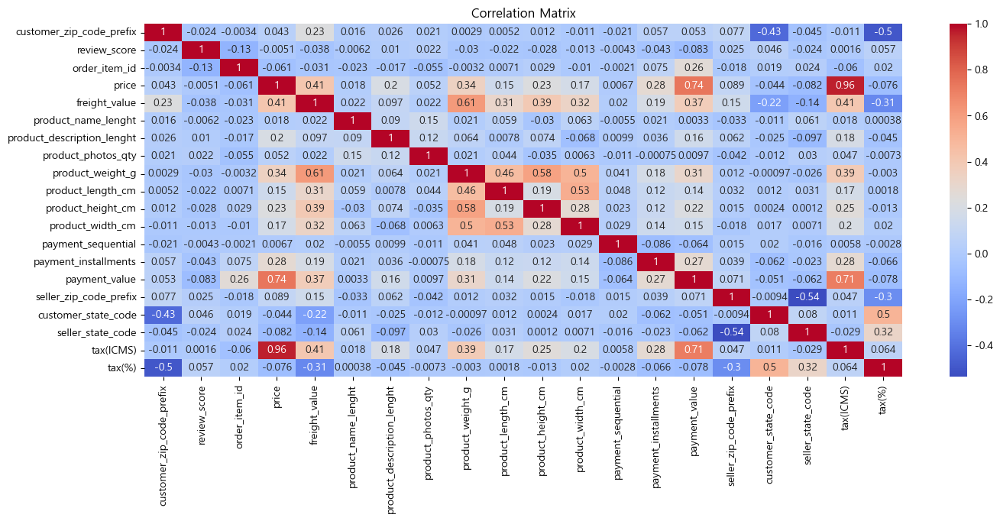

In [317]:
corr = df_merge.corr()

plt.figure(figsize=(16, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [318]:
time_columns= ['order_purchase_timestamp', 'order_approved_at','order_delivered_carrier_date','order_delivered_customer_date',
               'order_estimated_delivery_date', 'review_creation_date', 'review_answer_timestamp', 'shipping_limit_date']

df_merge[time_columns]=df_merge[time_columns].apply(pd.to_datetime)

In [319]:
customer_id_count = df_merge.groupby('customer_id').count()['customer_unique_id'].reset_index()
customer_id_count = customer_id_count.sort_values(by='customer_unique_id', ascending=False)
customer_id_count = customer_id_count.reset_index()
customer_id_count

,index,customer_id,customer_unique_id
0,14799,270c23a11d024a44c896d1894b261a83,63
1,7380,13aa59158da63ba0e93ec6ac2c07aacb,38
2,58458,9af2372a1e49340278e7c1ef8d749f34,29
3,55309,92cd3ec6e2d643d4ebd0e3d6238f69e2,26
4,37510,63b964e79dee32a3587651701a2b8dbf,24
...,...,...,...
96511,34395,5b7bd807fe0dcfe5208c642e07e268c9,1
96512,34394,5b7b7de303afbe0e48035449a3e86a5e,1
96513,34393,5b7b35a23a96b75f72bd1406d29a86c7,1
96514,34392,5b7ad66e4a9c19ef5ddceae95d05e46e,1


#### Customer Unique ID COUNT

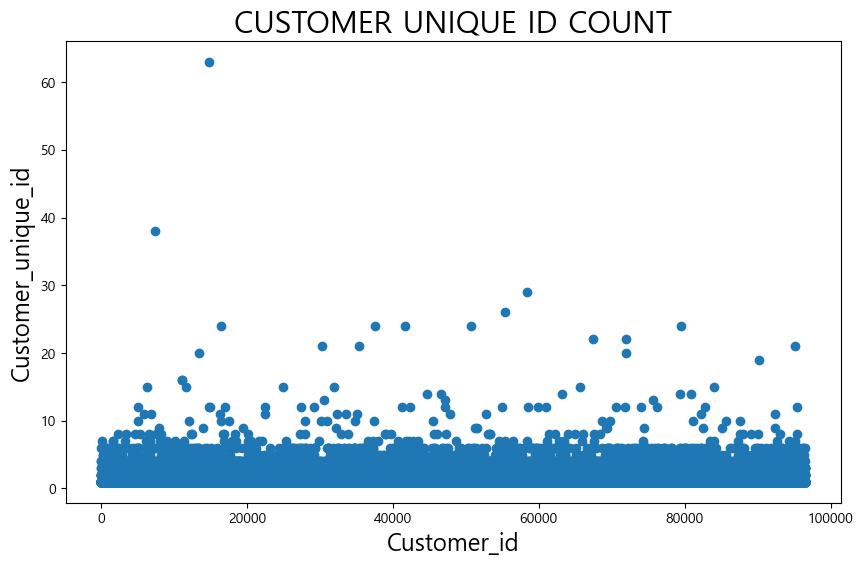

In [320]:
x = customer_id_count['index']
y = customer_id_count['customer_unique_id']

plt.figure(figsize=(10,6))
plt.title('CUSTOMER UNIQUE ID COUNT', fontsize=22)
s = plt.scatter(x,y)
plt.xlabel('Customer_id', fontsize=17)
plt.ylabel('Customer_unique_id', fontsize=17)
plt.show()

- customer unique ID 로 고객별 주문 횟수 확인 
- 한 고객이 10건 이상 구매한 경우 : 79 명 
- 한 고객이 10건 이하 구매한 경우 : 96437 명
- 한 고객이 1건만 구매한 경우 : 83927 명 

#### Customer's State Distribution

In [321]:
# clients number of each state
cli_num_state = df_merge.groupby(['customer_state']).count()['customer_unique_id'].reset_index().sort_values(by='customer_unique_id', ascending=False)
cli_num_state.head()

,customer_state,customer_unique_id
25,SP,48797
18,RJ,14987
10,MG,13429
22,RS,6413
17,PR,5879


In [322]:
# clients number of each city
cli_num_city = df_merge.groupby(['customer_city']).count()['customer_unique_id'].reset_index().sort_values(by='customer_unique_id', ascending=False)
cli_num_city.head()

,customer_city,customer_unique_id
3574,sao paulo,18267
3135,rio de janeiro,8022
451,belo horizonte,3196
556,brasilia,2434
1139,curitiba,1790


(0.0, 53676.700000000004)

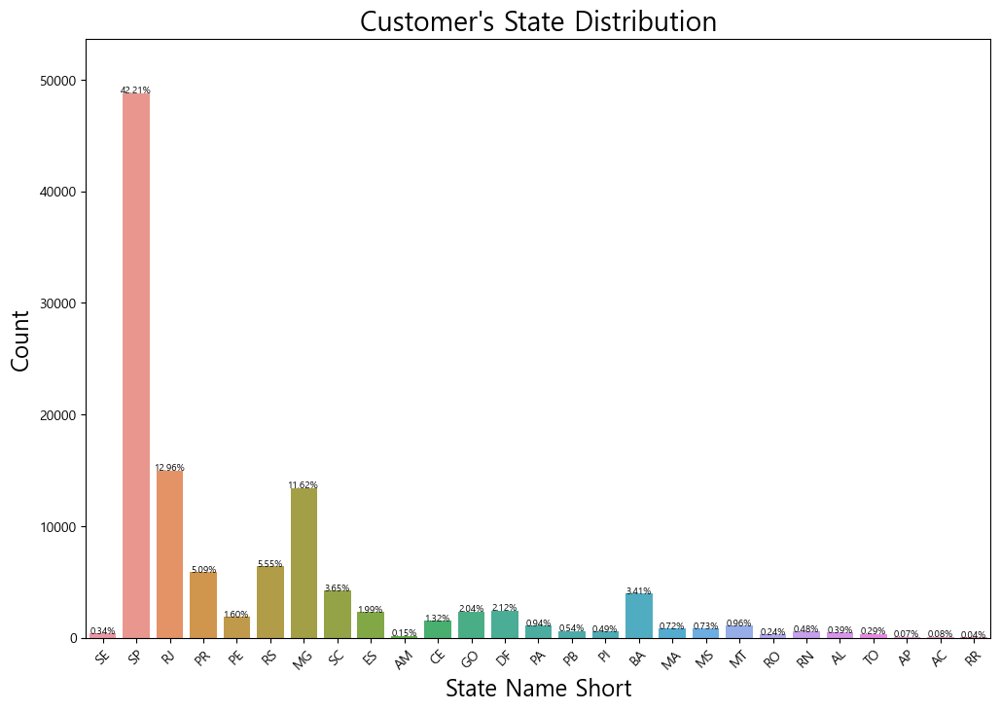

In [323]:
plt.figure(figsize=(12,8))
plt.title('CUSTOMER State Distributions', fontsize=22)
g = sns.countplot(x='customer_state', data=df_merge, orient='h')
g.set_title("Customer's State Distribution", fontsize=20)
g.set_xlabel("State Name Short", fontsize=17)
g.set_ylabel("Count", fontsize=17)
g.set_xticklabels(g.get_xticklabels(),rotation=45)
sizes = []
for p in g.patches:
    height = p.get_height()
    sizes.append(height)
    g.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format(height/len(df_merge)*100),
            ha="center", fontsize=7) 
g.set_ylim(0, max(sizes) * 1.1)

#### Customer's State by Price

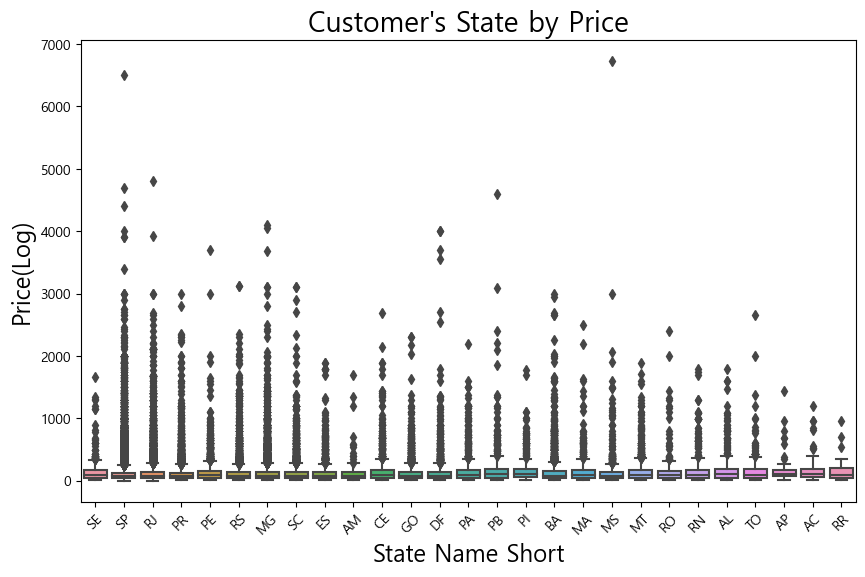

In [324]:
df_merge['price_log'] = np.log(df_merge['price'] + 1.5)
plt.figure(figsize=(10,6))

g2 = sns.boxplot(x='customer_state', y='price', 
                 data=df_merge)
g2.set_title("Customer's State by Price", fontsize=20)
g2.set_xlabel("State Name Short", fontsize=17)
g2.set_ylabel("Price(Log)", fontsize=17)
g2.set_xticklabels(g2.get_xticklabels(),rotation=45)
plt.show();

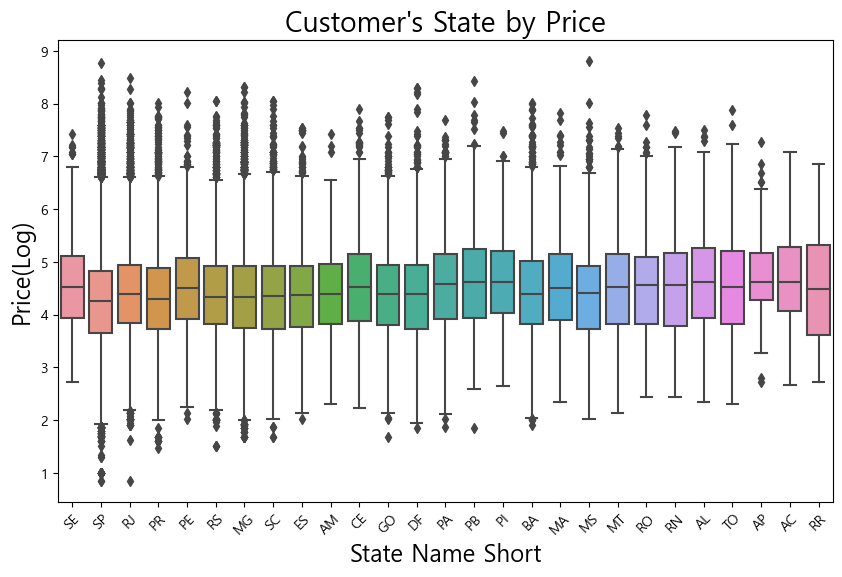

In [325]:
df_merge['price_log'] = np.log(df_merge['price'] + 1.5)
plt.figure(figsize=(10,6))

g2 = sns.boxplot(x='customer_state', y='price_log', 
                 data=df_merge[df_merge['price'] != -1])
g2.set_title("Customer's State by Price", fontsize=20)
g2.set_xlabel("State Name Short", fontsize=17)
g2.set_ylabel("Price(Log)", fontsize=17)
g2.set_xticklabels(g2.get_xticklabels(),rotation=45)
plt.show();

#### Customer's State by Freight Value

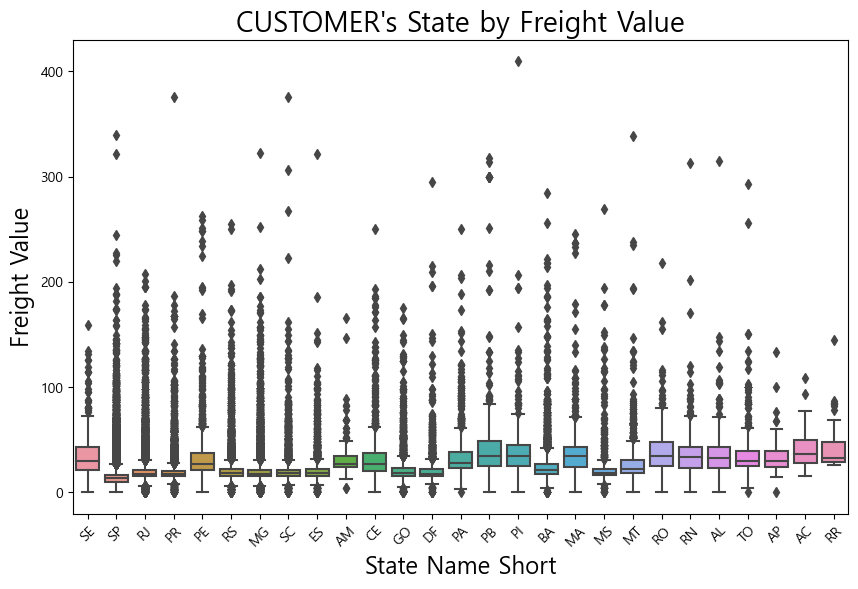

In [326]:
plt.figure(figsize=(10,6))
g3 = sns.boxplot(x='customer_state', y='freight_value', 
                 data=df_merge)
g3.set_title("CUSTOMER's State by Freight Value", fontsize=20)
g3.set_xlabel("State Name Short", fontsize=17)
g3.set_ylabel("Freight Value", fontsize=17)
g3.set_xticklabels(g3.get_xticklabels(),rotation=45)

plt.subplots_adjust(hspace = 0.5, top = 0.9)

#### Customer's State

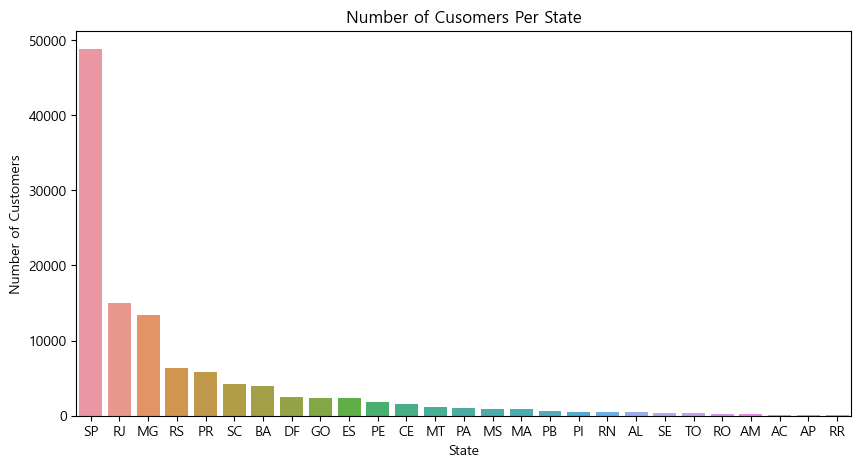

In [327]:
state_df = df_merge.groupby('customer_state').count()['customer_id'].reset_index()
city_df = df_merge.groupby('customer_city').count()['customer_id'].reset_index()

plt.figure(figsize=(10,5))

# state 별 고객 분포도 

sns.barplot(data = state_df.sort_values('customer_id', ascending = False),x = 'customer_state', y = 'customer_id')
plt.title('Number of Cusomers Per State')
plt.xlabel('State')
plt.ylabel('Number of Customers')
plt.show();

#### city 별 고객 분포도 

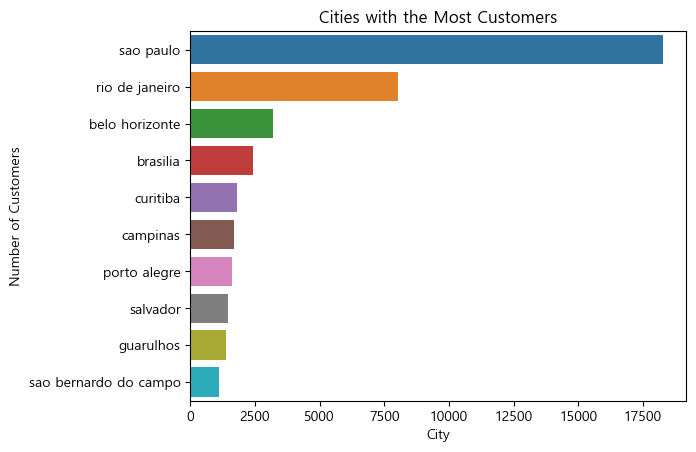

In [328]:
sns.barplot(data = city_df.sort_values('customer_id', ascending = False).nlargest(10, 'customer_id'), x = 'customer_id', y='customer_city')
plt.title('Cities with the Most Customers')
plt.xlabel('City')
plt.ylabel('Number of Customers')
plt.show();

- 대부분의 고객들의 state, city는 Sao paulo, rio de janeiro에 분포되고 있다. 

---

### 2) 상품 

In [350]:
query="""
SELECT *
FROM customer
INNER JOIN orders ON customer.customer_id = orders.customer_id
INNER JOIN order_reviews ON orders.order_id = order_reviews.order_id
INNER JOIN order_items ON orders.order_id = order_items.order_id
INNER JOIN products ON order_items.product_id = products.product_id
INNER JOIN sellers ON order_items.seller_id = sellers.seller_id 
"""
df_jw=get_query(query)


In [352]:
df_jw=df_jw.loc[:, ~df_jw.columns.duplicated(keep='first')]
# category 포르투갈어 -> 영어
df_jw_1 = df_jw.merge(olist_products_name_translation, on='product_category_name')

#### 카테고리별 주문 수 

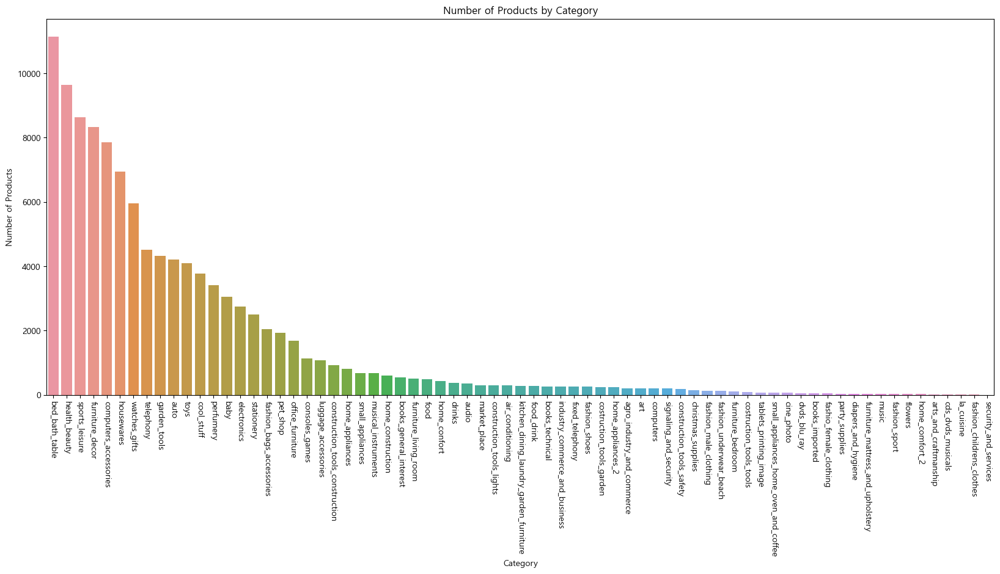

In [353]:
# 카테고리별 주문 개수
cnt=df_jw_1['product_category_name_english'].value_counts()

plt.figure(figsize=(20,8))
plt.title('Number of Products by Category')
sns.countplot(df_jw_1,x='product_category_name_english',order=df_jw_1['product_category_name_english'].value_counts().index)
plt.xticks(rotation=-90)
plt.xlabel('Category')
plt.ylabel('Number of Products')
plt.show()


In [203]:
# 새로고침
query="flush privileges;"
conn.execute(text(query))

#### 카테고리별 주문수 TOP10

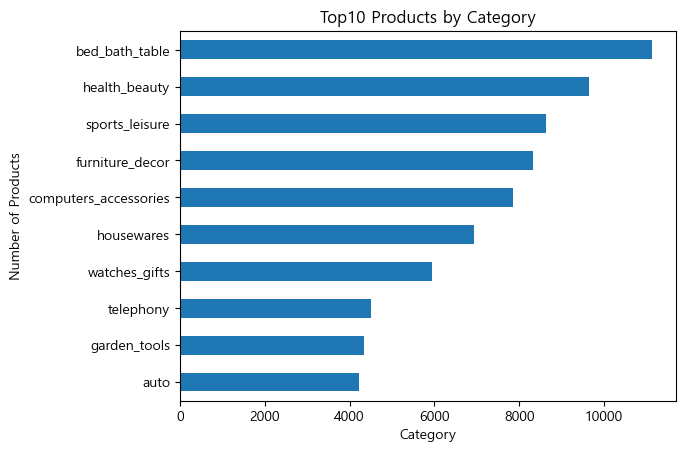

In [354]:
top_10=cnt[:10].sort_values(ascending=True)

top_10.plot(kind='barh')
plt.title('Top10 Products by Category')
plt.xlabel('Category')
plt.ylabel('Number of Products')
plt.show()

- Top10 : bed_bath_table, sports_leisure, furniture_decor, health_beauty, housewares, auto, computers_accessories, toys, watches_gifts, telophony
- 10개 미만 팔린 제품 : tablets_printing_image, fashion_childrens_clothes, home_comfort_2, security_and_services, cds_dvds_musicals

#### 지역별 상품 best

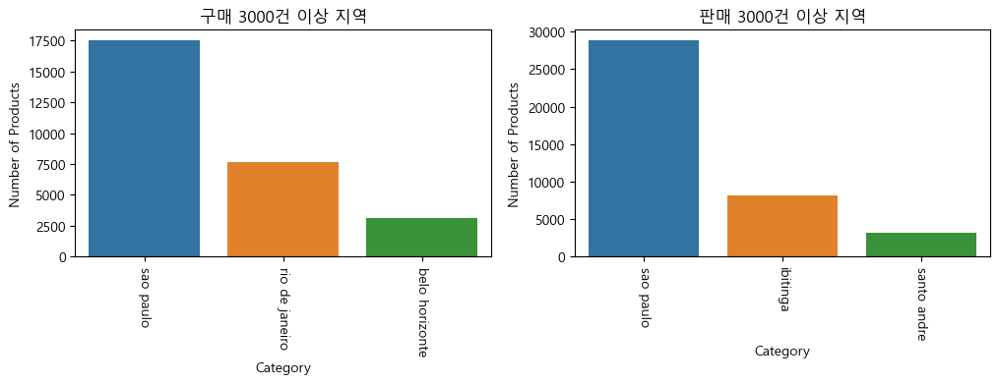

In [355]:
plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
plt.title('구매 3000건 이상 지역')
sns.countplot(df_jw_1,x='customer_city',order=df_jw_1.customer_city.value_counts()[:3].index)
plt.xticks(rotation=-90)
plt.xlabel('Category')
plt.ylabel('Number of Products')

plt.subplot(1,2,2)
plt.title('판매 3000건 이상 지역')
sns.countplot(df_merge,x='seller_city',order=df_merge.seller_city.value_counts()[:3].index)
plt.xticks(rotation=-90)
plt.xlabel('Category')
plt.ylabel('Number of Products')
plt.show()

- 3000건 이상 구매 : sao paulo , rio de janeiro, belo horizonte
- 3000건 이하 판매 : sao paulo, ibitinga, santo andre 

#### 카테고리별 상품 수

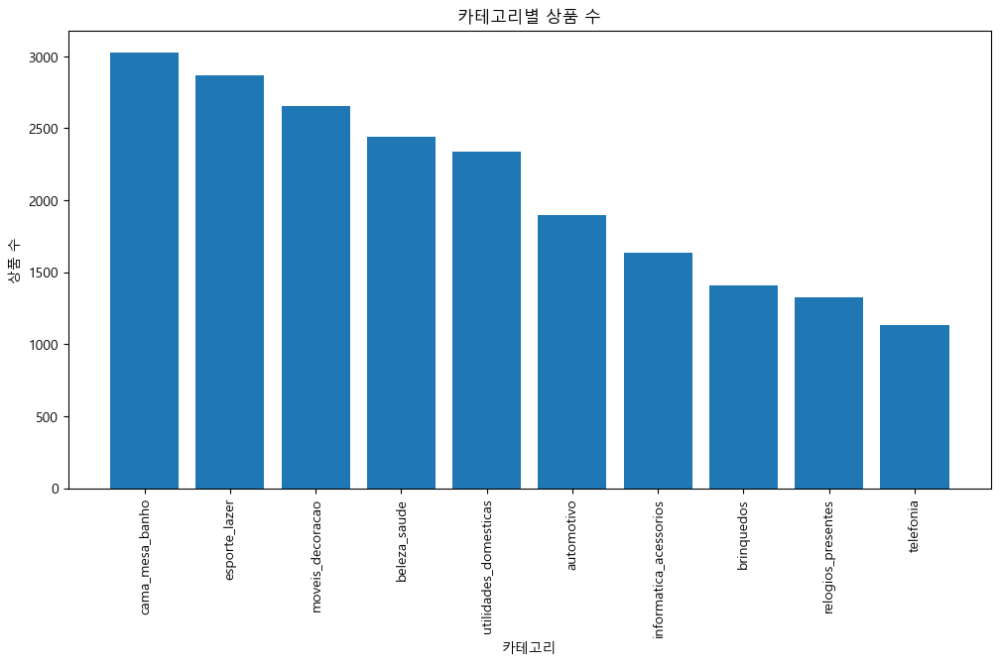

In [356]:
category_counts = olist_products['product_category_name'].value_counts().head(10)

plt.figure(figsize=(12, 6))
plt.bar(category_counts.index, category_counts.values)
plt.xlabel('카테고리')
plt.ylabel('상품 수')
plt.title('카테고리별 상품 수')
plt.xticks(rotation=90)
plt.show()

#### 상품 크기(부피) 분포

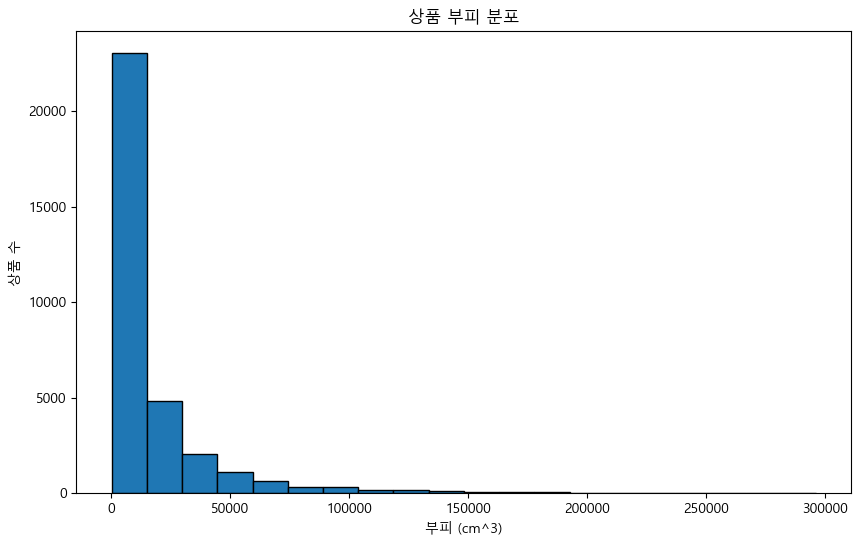

In [357]:
olist_products['product_volume_cm3'] = olist_products['product_length_cm'] * olist_products['product_height_cm'] * olist_products['product_width_cm']

plt.figure(figsize=(10, 6))
plt.hist(olist_products['product_volume_cm3'], bins=20, edgecolor='k')
plt.xlabel('부피 (cm^3)')
plt.ylabel('상품 수')
plt.title('상품 부피 분포')
plt.show()


---

### 3) 주문

In [427]:
query=""" 
SELECT *
FROM orders o
LEFT JOIN order_items oi ON o.order_id = oi.order_id
LEFT JOIN order_payments op ON o.order_id = op.order_id
LEFT JOIN customer c ON o.customer_id = c.customer_id;

"""
df_jo=get_query(query)

In [428]:
df_jo=df_jo.loc[:, ~df_jo.columns.duplicated(keep='first')]

#### 주문상태

In [417]:
def count_plot(df_jo, x, palette, title, xlabel, ylabel):
    total = len(df_jo)

    plt.figure(figsize=(10,6))

    ax = sns.countplot(x=x, palette=palette)
    plt.title(title,fontsize=20)
    plt.xlabel(xlabel,fontsize=15)
    plt.ylabel(ylabel,fontsize=15)

    sizes = []
    for p in ax.patches:
        height = p.get_height()
        sizes.append(height)
        ax.text(p.get_x()+p.get_width()/2.,
                height + 3,
                '{:1.1f}%'.format(height/total*100),
                ha="center", fontsize=10) 
        
    ax.set_ylim(0, max(sizes) * 1.1)

    plt.show()
    

In [418]:
def count_plot_2(df, x, palette, order, title, xlabel, ylabel):
    total = len(df)

    plt.figure(figsize=(10,6))

    ax = sns.countplot(x=x, palette=palette, order=order)
    plt.title(title,fontsize=20)
    plt.xlabel(xlabel,fontsize=15)
    plt.ylabel(ylabel,fontsize=15)

    sizes = []
    for p in ax.patches:
        height = p.get_height()
        sizes.append(height)
        ax.text(p.get_x()+p.get_width()/2.,
                height + 3,
                '{:1.1f}%'.format(height/total*100),
                ha="center", fontsize=10) 
        
    ax.set_ylim(0, max(sizes) * 1.1)

    plt.show()

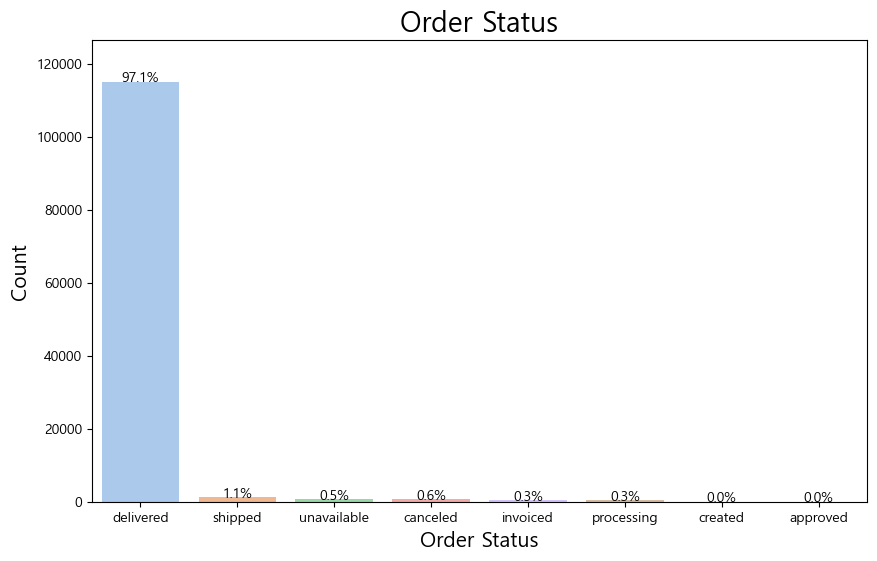

In [429]:
count_plot(df_jo, df_jo['order_status'], 'pastel', 'Order Status', 'Order Status', 'Count')

- 주문 상태는 역시나 배달이 가장 많았고 취소 주문건수는 0.63%
- 전체 주문건수가 많은 지역이 취소 주문건수도 많을지, 아니면 전체 주문건수와 상관없이 취소 주문건수가 많은 지역이 있을지 추가적으로 EDA 진행

#### 주문상태 '취소' 지역별 주문건수

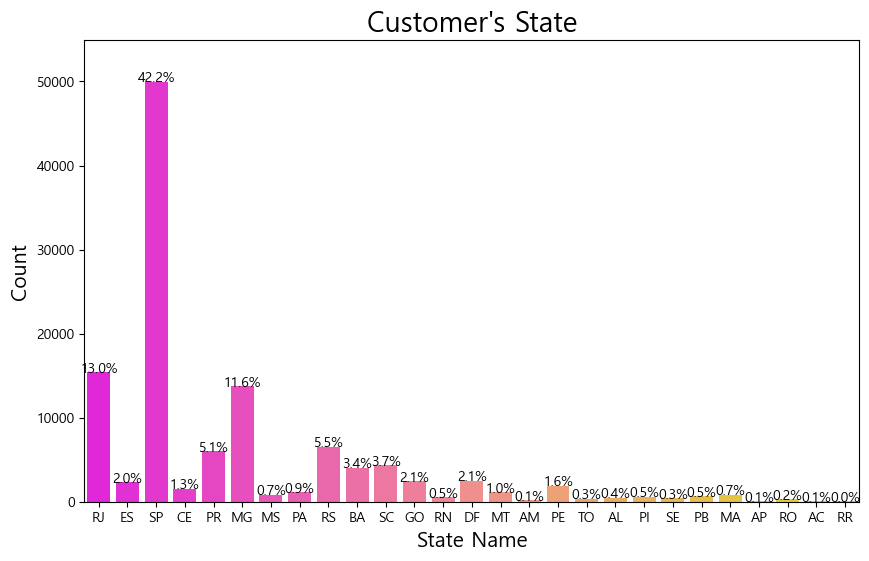

In [430]:
count_plot(df_jo, df_jo['customer_state'], 'spring', "Customer's State", 'State Name', 'Count')

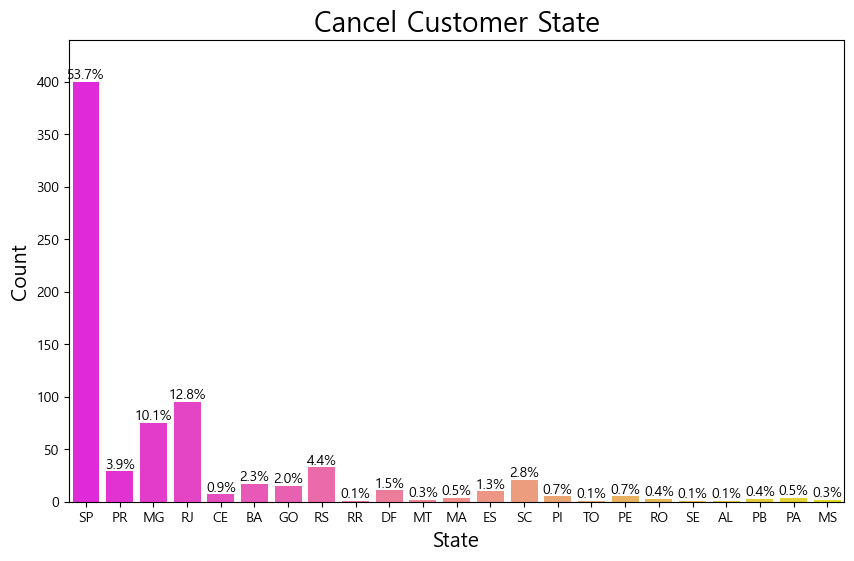

In [431]:
cancel = df_jo[df_jo['order_status']=='canceled']

count_plot(cancel, cancel['customer_state'], 'spring', 'Cancel Customer State', 'State', 'Count')

- SP, RJ, MG, RS, PR 등의 지역순으로 주문건수가 많았고 취소 주문건수 또한 같은 순서임
- 특정 지역의 이슈가 있지 않다면 대체로 주문건수가 많은 지역의 취소 주문건수도 증가

#### 일자(년도, 월, 요일, 시간 등)에 따른 주문건수

In [432]:
# datetime으로 형변환

df_jo['order_purchase_timestamp'] = pd.to_datetime(df_jo.order_purchase_timestamp)
df_jo['order_approved_at'] = pd.to_datetime(df_jo.order_approved_at)
df_jo['order_delivered_carrier_date'] = pd.to_datetime(df_jo.order_delivered_carrier_date)
df_jo['order_delivered_customer_date'] = pd.to_datetime(df_jo.order_delivered_customer_date)
df_jo['order_estimated_delivery_date'] = pd.to_datetime(df_jo.order_estimated_delivery_date)

In [433]:
# 필요한 컬럼 생성

df_jo['order_purchase_year'] = df_jo['order_purchase_timestamp'].dt.strftime('%Y')
df_jo['order_purchase_month'] = df_jo['order_purchase_timestamp'].dt.strftime('%-m')
df_jo['order_purchase_month_name'] = df_jo['order_purchase_timestamp'].dt.strftime('%h')
df_jo['order_purchase_year_month']=df_jo['order_purchase_year'] + df_jo['order_purchase_timestamp'].dt.strftime('%m')
df_jo['order_purchase_day'] = df_jo['order_purchase_timestamp'].dt.strftime('%-d')
df_jo['order_purchase_date'] = df_jo['order_purchase_year'] + df_jo['order_purchase_month'] + df_jo['order_purchase_day']
df_jo['order_purchase_dayofweek'] = df_jo['order_purchase_timestamp'].dt.strftime('%w')
df_jo['order_purchase_dayofweek_name'] = df_jo['order_purchase_timestamp'].dt.strftime('%a')
df_jo['order_purchase_hour'] = df_jo['order_purchase_timestamp'].dt.strftime('%H')

In [434]:
olist_orders['order_purchase_timestamp'] = pd.to_datetime(olist_orders['order_purchase_timestamp'])

olist_orders['order_purchase_year'] = olist_orders['order_purchase_timestamp'].dt.year
olist_orders['order_purchase_month'] = olist_orders['order_purchase_timestamp'].dt.month
olist_orders['order_purchase_day'] = olist_orders['order_purchase_timestamp'].dt.day
olist_orders['order_purchase_dayofweek'] = olist_orders['order_purchase_timestamp'].dt.day_of_week
olist_orders['order_purchase_date'] = olist_orders['order_purchase_timestamp'].dt.date
olist_orders['order_purchase_hour'] = olist_orders['order_purchase_timestamp'].dt.hour
olist_orders['order_purchase_year_month'] = olist_orders['order_purchase_timestamp'].dt.strftime('%Y%m')

#### 년도별 주문건수

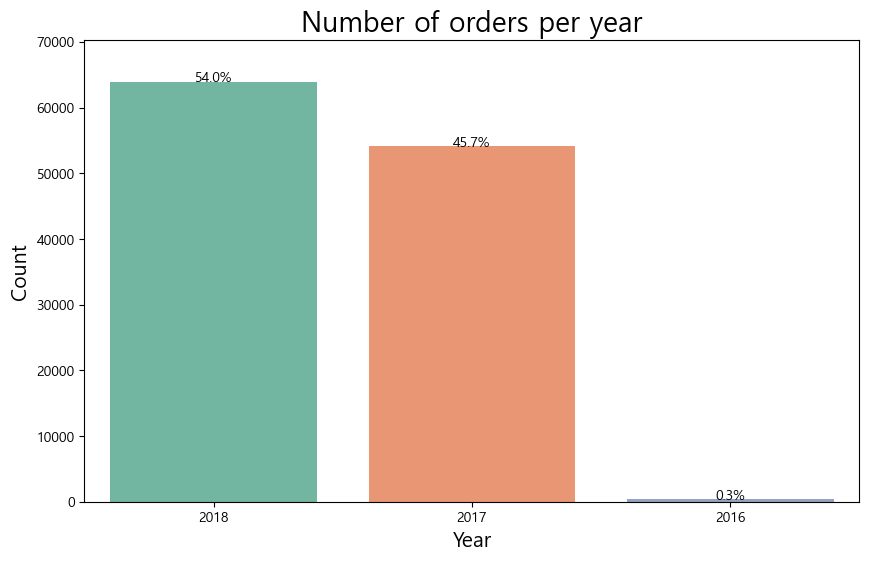

In [435]:
count_plot_2(df_jo, df_jo['order_purchase_year'], 'Set2', df_jo['order_purchase_year'].value_counts().index, 'Number of orders per year', 'Year', 'Count')

#### 월별 주문건수 

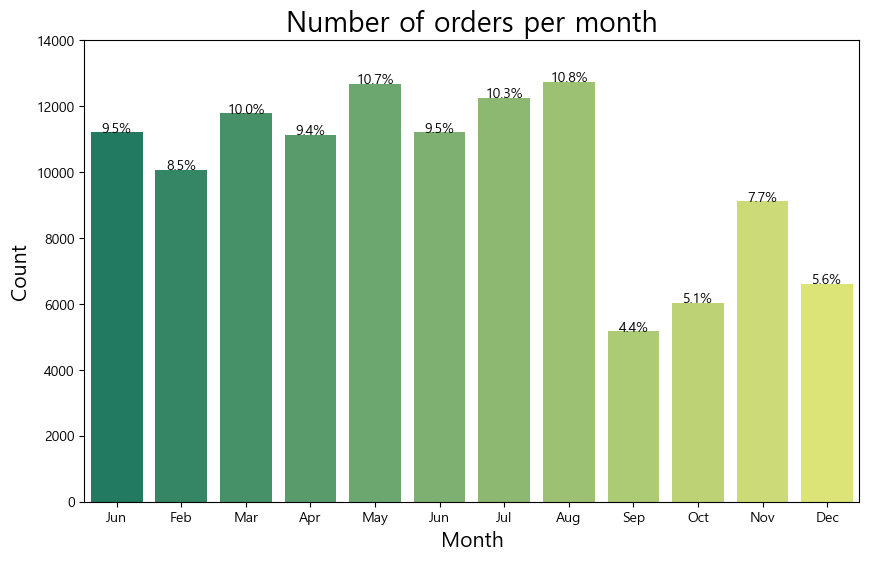

In [436]:
count_plot_2(df_jo, df_jo['order_purchase_month_name'], 'summer', ['Jun', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], 'Number of orders per month', 'Month', 'Count')

- 남미의 계절 : 봄(9월~11월), 여름(12월~2월), 가을(3월~5월), 겨울(6월~8월)
- 브라질 사람들은 봄보다는 여름~겨울에 e-commerce 주문량이 높다.

#### 일별 주문건수

In [ ]:
count_plot_2(df_jo, df_jo['order_purchase_day'], 'winter',[str(i) for i in range(1,32)], 'Number of orders per day', 'Day', 'Count')

#### 요일별 주문건수

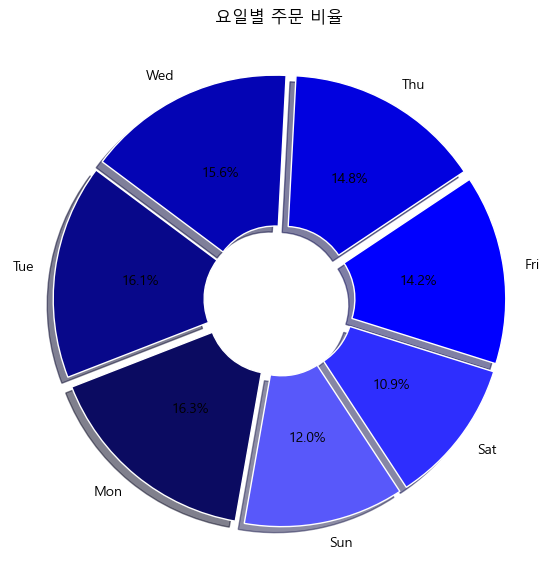

In [100]:
# 요일별 주문수 비율 파이차트
ratio = [16.3, 16.1, 15.6, 14.8, 14.2, 10.9, 12.0]
labels = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

explode = [0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05]
colors = ['#0B0B61', '#08088A', '#0404B4', '#0101DF', '#0000FF', '#2E2EFE', '#5858FA'] 
wedgeprops={'width': 0.7, 'edgecolor': 'w', 'linewidth': 1}

plt.figure(figsize=(7,7))
plt.pie(ratio, labels=labels, autopct='%.1f%%', startangle=260, counterclock=False, explode=explode, shadow=True, colors=colors, wedgeprops=wedgeprops)
plt.title('요일별 주문 비율')
plt.show()

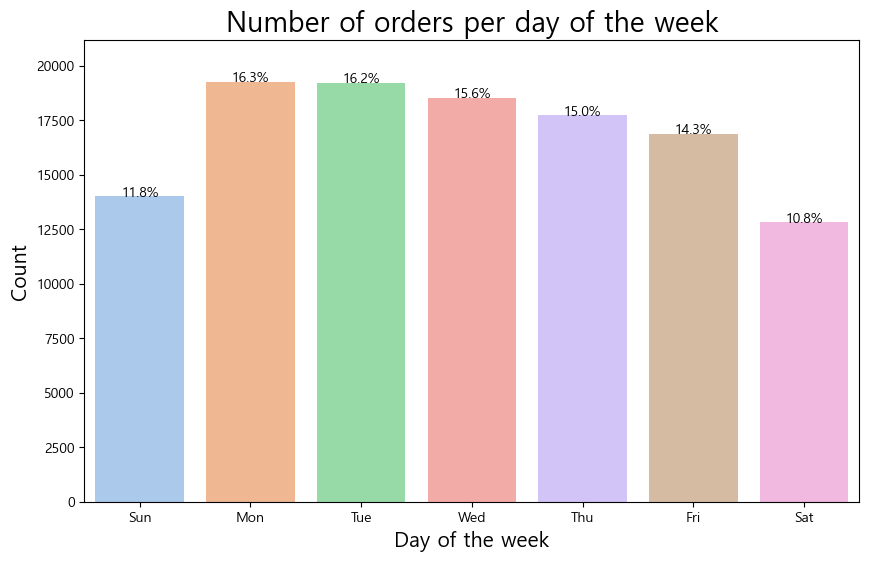

In [438]:
count_plot_2(df_jo, df_jo['order_purchase_dayofweek_name'], 'pastel', ['Sun','Mon','Tue','Wed','Thu','Fri','Sat'], 'Number of orders per day of the week', 'Day of the week', 'Count')

- 대체적으로 비슷한 수치를 보였지만, 의외로 토요일에 주문량이 가장 적었다.

#### 시간별 주문건수

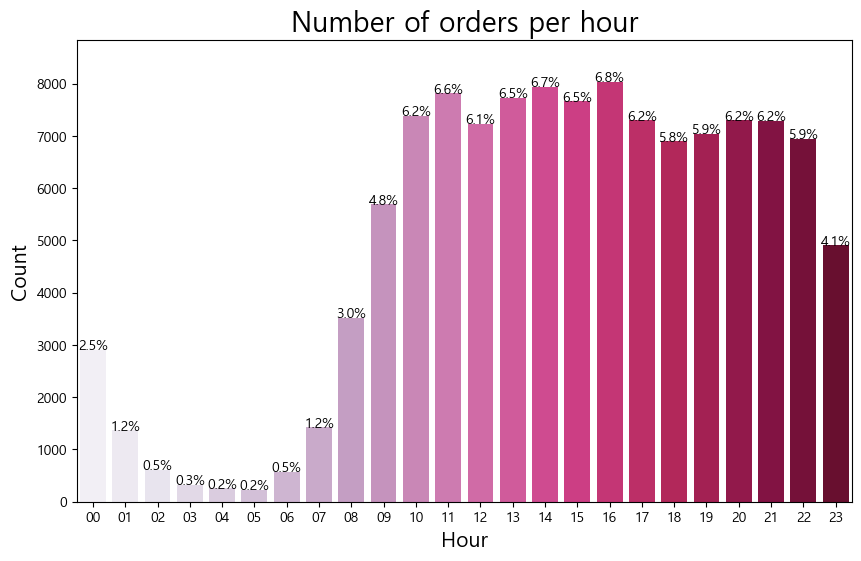

In [439]:
count_plot_2(df_jo, df_jo['order_purchase_hour'], 'PuRd', [str(i).zfill(2) for i in range(24)], 'Number of orders per hour', 'Hour', 'Count')

#### 년도 + 월별 주문건수

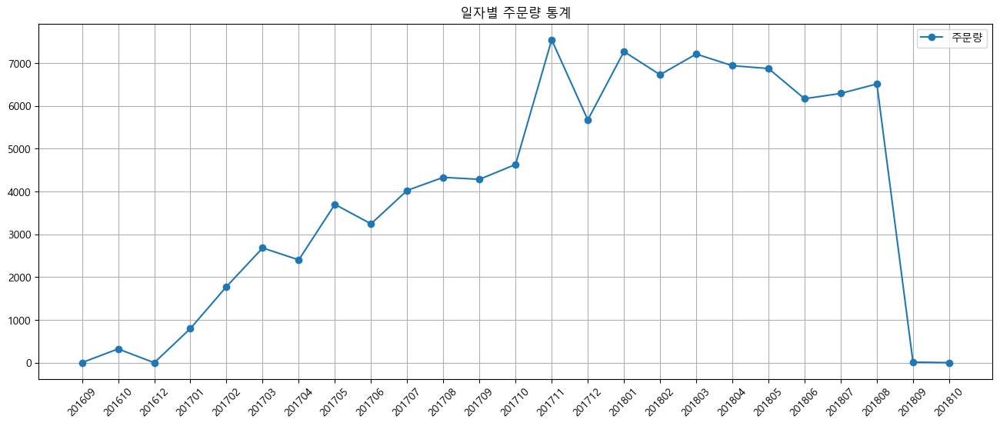

In [440]:
fig = plt.figure(figsize=(16,6)) 
fig.set_facecolor('white') 
ax = fig.add_subplot() 

ax.plot(olist_orders['order_purchase_year_month'].value_counts().sort_index(),marker='o',label='주문량')

ax.legend(loc='upper right');
ax.grid('whitegrid')
ax.set_title('일자별 주문량 통계')
plt.xticks(rotation=45)
plt.show()

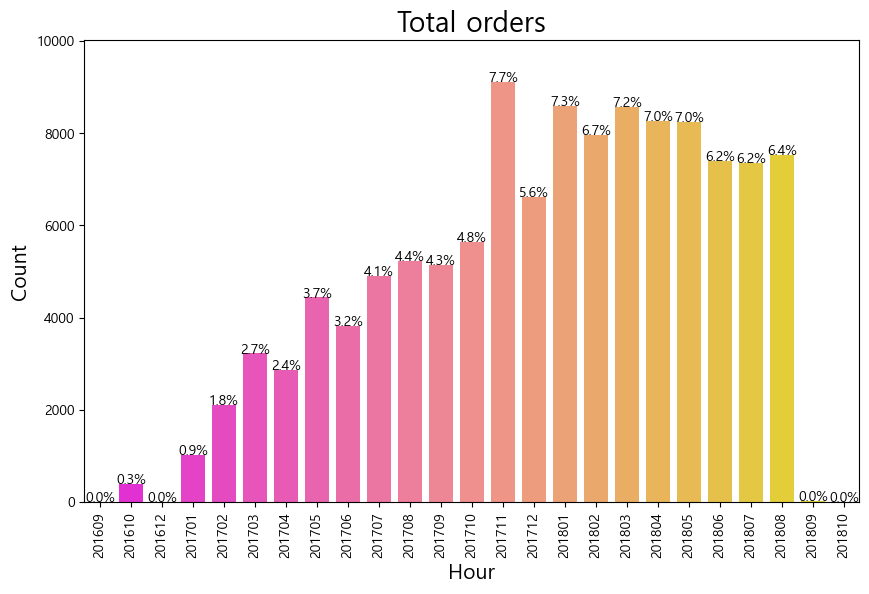

In [441]:
total = len(df_jo)

plt.figure(figsize=(10,6))

ax = sns.barplot(x=df_jo['order_purchase_year_month'].value_counts().index, y=df_jo['order_purchase_year_month'].value_counts().values, order=sorted(df_jo['order_purchase_year_month'].value_counts().index), palette='spring')
plt.title('Total orders',fontsize=20)
plt.xlabel('Hour',fontsize=15)
plt.ylabel('Count',fontsize=15)
plt.xticks(rotation='vertical')

sizes = []
for p in ax.patches:
    height = p.get_height()
    sizes.append(height)
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.1f}%'.format(height/total*100),
            ha="center", fontsize=10) 
    
ax.set_ylim(0, max(sizes) * 1.1)

plt.show()

- 년도, 월, 요일 등으로 나눠서 주문 건수 확인
- 년도 + 월 데이터로 확인하였을 때 점점 상승하는 그래프
- 주문건수가 점점 많아짐에 따라 매출도 같이 증가하는지 확인하기 위해 아래에 주별 매출 그래프 생성

In [442]:
time = df_jo[['order_id', 'order_purchase_timestamp', 'price']].set_index('order_purchase_timestamp', inplace=False)

df_time_jo = pd.DataFrame(time.resample('W')['price'].sum())
# 마지막 6주 연속으로 price가 0이어서 이상치로 판단해 제거
df_time_jo.drop(df_time_jo.tail(6).index, inplace=True)
df_time_jo

,price
order_purchase_timestamp,
2016-09-04,72.89
2016-09-11,59.50
2016-09-18,134.97
2016-09-25,0.00
2016-10-02,100.00
...,...
2018-08-12,288122.23
2018-08-19,257414.84
2018-08-26,128453.12


#### 지역에 따른 주문건수

In [443]:
# 지역정보(도시,주)를 가져오기 위해 데이터 merge
df_orders_customer_gw = olist_orders.merge(olist_customer, how='left', on='customer_id')

In [444]:
# Thanks : https://www.kaggle.com/code/thiagopanini/e-commerce-sentiment-analysis-eda-viz-nlp/notebook

import requests
import json

# 지역정보를 가져오기 위해 API 사용
r = requests.get('https://servicodados.ibge.gov.br/api/v1/localidades/mesorregioes')
content = [c['UF'] for c in json.loads(r.text)]
br_info = pd.DataFrame(content)
br_info['nome_regiao'] = br_info['regiao'].apply(lambda x: x['nome'])
br_info.drop('regiao', axis=1, inplace=True)
br_info.drop_duplicates(inplace=True)

# 지도외부지역 제거
# 북부 지역
geo_prep = olist_geolocation[olist_geolocation.geolocation_lat <= 5.27438888]
# 서부 지역.
geo_prep = geo_prep[geo_prep.geolocation_lng >= -73.98283055]
# 남부 지역.
geo_prep = geo_prep[geo_prep.geolocation_lat >= -33.75116944]
# 동부 지역.
geo_prep = geo_prep[geo_prep.geolocation_lng <=  -34.79314722]
geo_group = geo_prep.groupby(by='geolocation_zip_code_prefix', as_index=False).min()

# 데이터 merge
df_orders_customer_gw = df_orders_customer_gw.merge(br_info, how='left', left_on='customer_state', right_on='sigla')
df_orders_customer_gw = df_orders_customer_gw.merge(geo_group, how='left', left_on='customer_zip_code_prefix', 
                                        right_on='geolocation_zip_code_prefix')
df_orders_customer_gw.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_purchase_year,order_purchase_month,...,customer_state,id,sigla,nome,nome_regiao,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,2017,10,...,SP,35,SP,São Paulo,Sudeste,3149.0,-23.583885,-46.587473,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,2018,7,...,BA,29,BA,Bahia,Nordeste,47813.0,-12.945892,-45.016313,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,2018,8,...,GO,52,GO,Goiás,Centro-Oeste,75265.0,-16.752735,-48.522139,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,2017,11,...,RN,24,RN,Rio Grande do Norte,Nordeste,59296.0,-5.778488,-35.281450,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,2018,2,...,SP,35,SP,São Paulo,Sudeste,9195.0,-23.760018,-46.524784,santo andre,SP


#### 주문량 상위 10개 도시

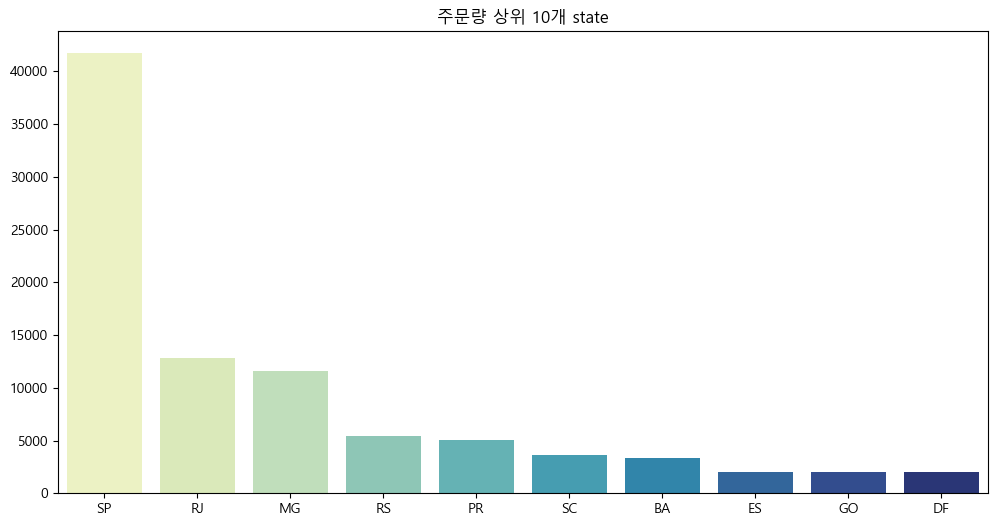

In [445]:
plt.subplots(figsize=(12,6))
sns.barplot(x=df_orders_customer_gw['geolocation_state'].value_counts().nlargest(10).index,y=df_orders_customer_gw['geolocation_state'].value_counts()[:10].values,palette='YlGnBu')
plt.title('주문량 상위 10개 state')
plt.show()

- 브라질의 가장 유명한 상파울루(주)가 가장 많은 주문량을 기록했다.
- 그렇다면 예상대로 2017년11월 ~ 2018년8월까지 상파울루 도시는 많은 주문량을 기록했을까?

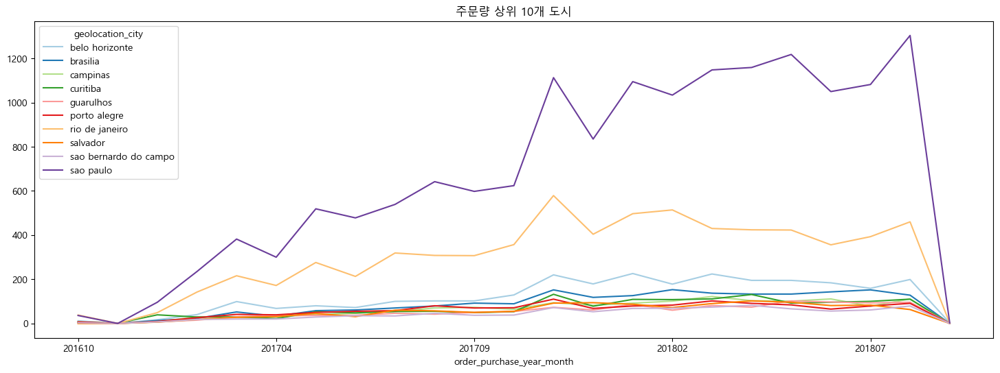

In [222]:
# 주문량 상위 10개 도시
top_region10=df_orders_customer_gw[df_orders_customer_gw['geolocation_city'].isin(df_orders_customer_gw['geolocation_city'].value_counts().nlargest(10).index)]
pd.crosstab(top_region10.order_purchase_year_month,top_region10.geolocation_city).plot(color=sns.color_palette('Paired',10))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.title('주문량 상위 10개 도시')
plt.show()

- 역시나 상파울루가 가장 많은 주문량을 기록했다.
- 일자를 보아도 앞선 '일자에 따른 주문건수' 분석결과와 마찬가지로 2017년11월 ~ 2018년8월까지 가장 높은 주문량을 기록했다.

#### 지역별 전체 주문량

In [108]:
df_tmp = df_orders_customer_gw.copy()
df_tmp.dropna(subset=['geolocation_lat','geolocation_lat'],inplace=True)

from folium import plugins
regional_count = df_tmp[['geolocation_lat','geolocation_lng']].dropna()
m = folium.Map([-15, -50], zoom_start=4) 

plugins.Fullscreen(position='topright',
                   title='Click to Expand', 
                   title_cancel='Click to Exit', 
                   force_separate_button=True).add_to(m)

plugins.MousePosition().add_to(m)
plugins.MarkerCluster(regional_count).add_to(m)

m

In [ ]:
# 지역별 전체 주문량 히트맵
# Thanks : https://www.kaggle.com/code/thiagopanini/e-commerce-sentiment-analysis-eda-viz-nlp/notebook
from folium.plugins import HeatMap

# Grouping geolocation data for plotting a heatmap
heat_data = df_tmp.groupby(by=['geolocation_lat', 'geolocation_lng'], as_index=False).count().iloc[:, :3]

# Creating a mapa using folium
map1 = folium.Map(
    location=[-15, -50], 
    zoom_start=4.0, 
    tiles='cartodbdark_matter'
)

# Plugin: HeatMap
HeatMap(
    name='Mapa de Calor',
    data=heat_data,
    radius=10,
    max_zoom=13
).add_to(map1)

map1

- 히트맵으로 다시한번 살펴보면, 주문량은 남동지역에 고르게 분포되어있고 상파울루가 상대적으로 높은 주문량의 히트맵이 보여진다.

---

### 4) 판매

#### seller number of each state

In [358]:
sel_num_state = df_merge.groupby('seller_state').count()['seller_id'].reset_index().sort_values(by='seller_id', ascending=False).head(10)
sel_num_state.head()

,seller_state,seller_id
22,SP,82417
8,MG,9014
15,PR,8964
16,RJ,4906
20,SC,4221


In [368]:
query=""" 
SELECT *
FROM order_items
INNER JOIN orders ON order_items.order_id = orders.order_id
INNER JOIN products ON order_items.product_id = products.product_id
INNER JOIN sellers ON order_items.seller_id = sellers.seller_id
INNER JOIN order_reviews ON orders.order_id = order_reviews.order_id;
"""
merged_df_jb=get_query(query)

In [370]:
merged_df_jb=merged_df_jb.loc[:, ~merged_df_jb.columns.duplicated(keep='first')]

In [371]:
geolocation_subset_jb = olist_geolocation[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']]
merged_df_jb_1 = pd.merge(olist_sellers, geolocation_subset_jb, left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')
merged_df_jb_1.drop(['geolocation_zip_code_prefix'], axis=1, inplace=True)
merged_df_jb_1.rename(columns={'geolocation_lat': 'lat', 'geolocation_lng': 'lng'}, inplace=True)

In [374]:
# 중복된 seller_id를 제거한 데이터프레임 생성
unique_sellers_df_jb = merged_df_jb_1.drop_duplicates(subset='seller_id')

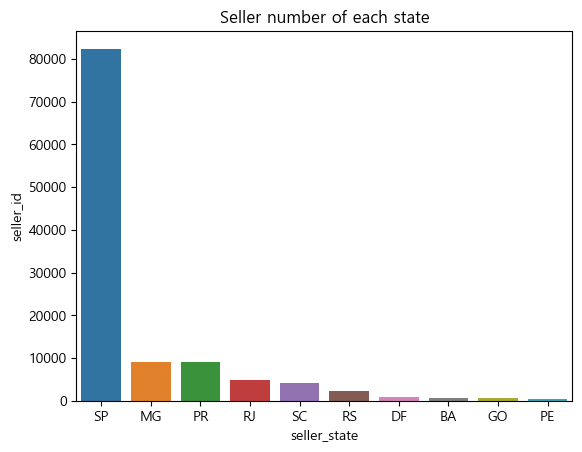

In [372]:
sns.barplot(data = sel_num_state, x = 'seller_state', y='seller_id')
plt.title('Seller number of each state')
plt.xlabel('seller_state')
plt.ylabel('seller_id')
plt.show();

In [331]:
sel_num_city = df_merge.groupby(['seller_state','seller_city']).count()['seller_id'].reset_index().sort_values(by='seller_id', ascending=False).head(10)
sel_num_city.head()

,seller_state,seller_city,seller_id
584,SP,sao paulo,28811
455,SP,ibitinga,8227
567,SP,santo andre,3131
162,PR,curitiba,3033
580,SP,sao jose do rio preto,2667


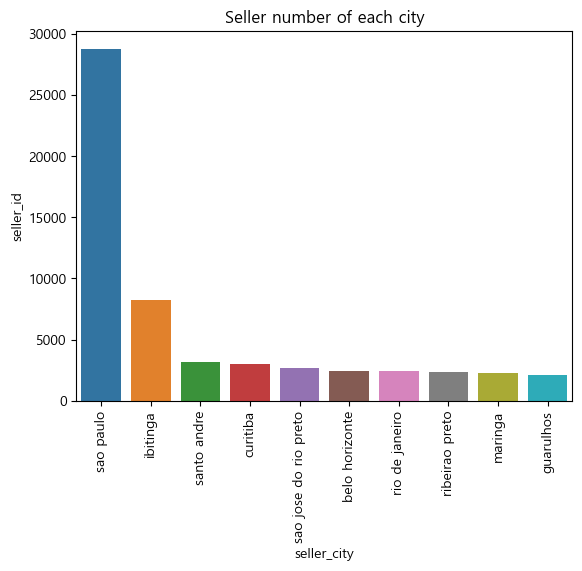

In [373]:
sns.barplot(data = sel_num_city, x ='seller_city', y='seller_id')
plt.title('Seller number of each city')
plt.xlabel('seller_city')
plt.xticks(rotation='vertical')
plt.ylabel('seller_id')
plt.show();

In [ ]:
import json
import plotly.express as px
geojson = json.load(open('brazil_geo.json'))

def plot_state_choropleth_map(data_frame, locations, geojson, color, color_continuous_scale='Reds',height=800,width=900):
    fig = px.choropleth(data_frame=data_frame, locations=locations, geojson=geojson, color=color, color_continuous_scale=color_continuous_scale, scope="south america")
    fig.update_layout(height=height, width=width,
                  title="지역별(주) 판매자 분포",
                  geo=dict(lonaxis = dict(range= [-33.0, -80.0]),lataxis = dict(range= [5.0, -35.0])))
    fig.show()

seller_counts = unique_sellers_df_jb.groupby('seller_state')['seller_id'].nunique().to_frame()
seller_counts = seller_counts.rename(columns={'seller_id': 'seller_count'})

plot_state_choropleth_map(data_frame=seller_counts, locations=seller_counts.index, geojson=geojson, color="seller_count")

- sao paulo	: 브라질 최대 도시, 인구가 가장 많은 도시 
- ibitinga : 상파울루 주 내 도시 
- santo andre : 공업도시 
- curitiba : 브라질에서 정치, 경제, 문화의 중심지
- belo horizonte : 브라질 도시 중 6번째로 인구수가 많은 도시 
- rio de janeiro : 상파울루 이은 제2의 경제 규모 도시 

#### number of products people usually order

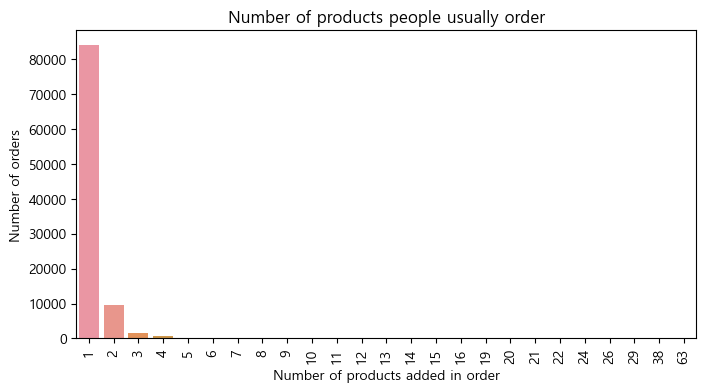

In [375]:
plt.figure(figsize=(8,4))
ax=sns.countplot(x='customer_unique_id', data=customer_id_count)
ax.set_xlabel("Number of products added in order")
ax.set_ylabel("Number of orders")
ax.set_title("Number of products people usually order")
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

#### Most Bought product categories

In [376]:
product = df_merge.groupby('product_category_name_english').aggregate({'order_id' : 'count'}).rename(columns={'order_id':'order_count'}).sort_values(by='order_count', ascending=False).reset_index()
product.head()

,product_category_name_english,order_count
0,bed_bath_table,11847
1,health_beauty,9944
2,sports_leisure,8942
3,furniture_decor,8743
4,computers_accessories,8105


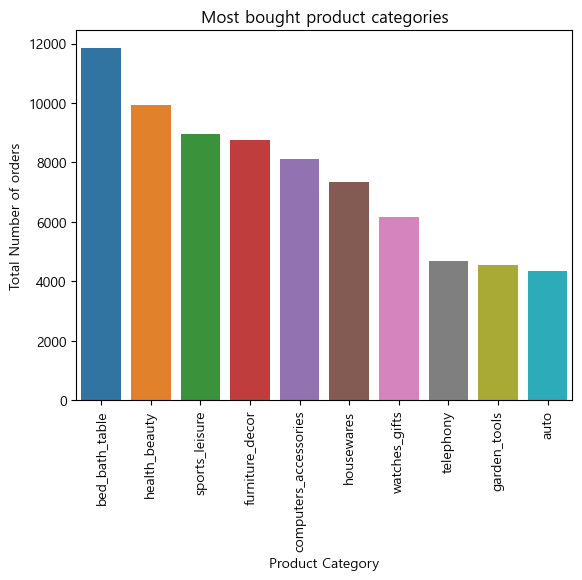

In [333]:
# Visualising top 10 most bought product categories:
sns.barplot(x='product_category_name_english',y='order_count',data=product[:10])
plt.xlabel("Product Category")
plt.ylabel("Total Number of orders")
plt.title("Most bought product categories")
plt.xticks(rotation='vertical')
plt.show()

#### bottom 10 most bought product categories

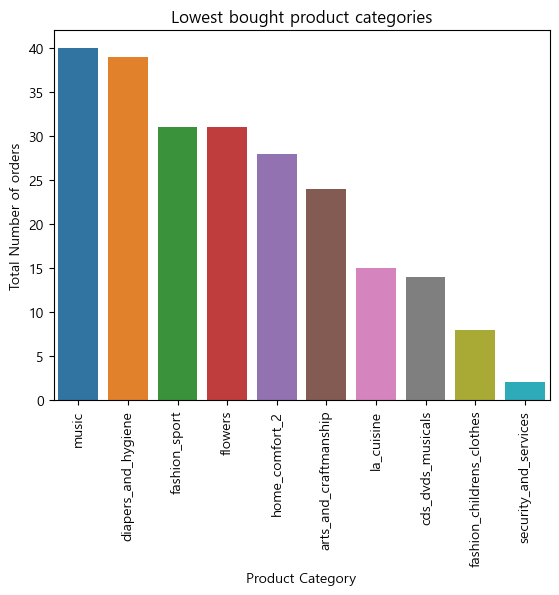

In [334]:
sns.barplot(x='product_category_name_english',y='order_count',data=product[-10:])
plt.xlabel("Product Category")
plt.ylabel("Total Number of orders")
plt.title("Lowest bought product categories")
plt.xticks(rotation='vertical')
plt.show()

#### Seller ID 가장 많은 상품 판 Seller

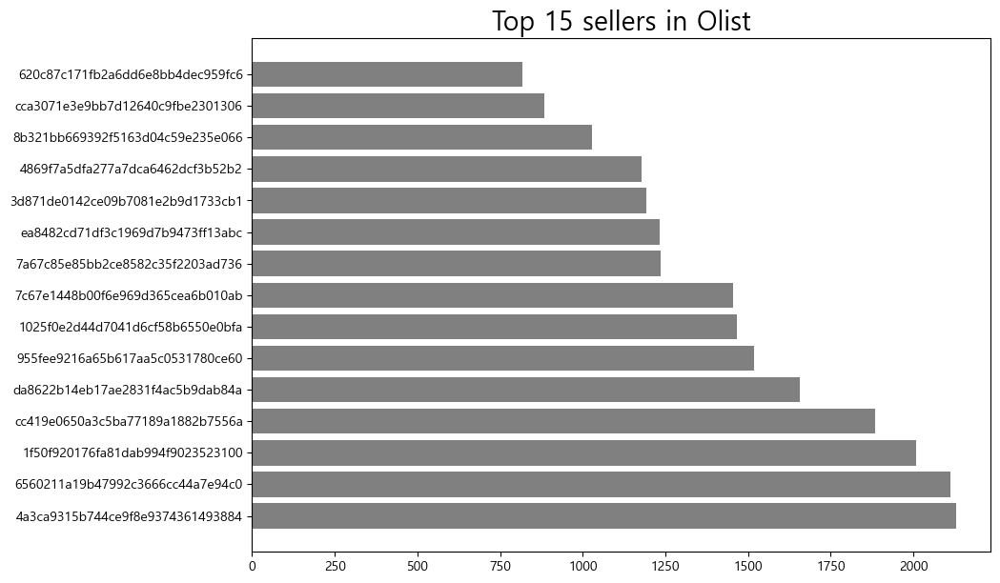

In [335]:
plt.figure(figsize=(10,7))
a = plt.barh(df_merge['seller_id'].value_counts()[:15].index, df_merge['seller_id'].value_counts()[:15].values, color='gray')
plt.title('Top 15 sellers in Olist',fontsize=20)
plt.show()

In [336]:
# - seller 분들의 단골 고객 찾아보기 
# - seller 분들 top, bottom 10 
seller_top1 = df_merge[df_merge['seller_id']=='4a3ca9315b744ce9f8e9374361493884']
seller_top2 = df_merge[df_merge['seller_id']=='6560211a19b47992c3666cc44a7e94c0']
seller_top3 = df_merge[df_merge['seller_id']=='1f50f920176fa81dab994f9023523100']
seller_top4 = df_merge[df_merge['seller_id']=='cc419e0650a3c5ba77189a1882b7556a']
seller_top5 = df_merge[df_merge['seller_id']=='955fee9216a65b617aa5c0531780ce60']
seller_top6 = df_merge[df_merge['seller_id']=='1025f0e2d44d7041d6cf58b6550e0bfa']

Text(0.5, 0.98, 'Top 6 sellers product category')

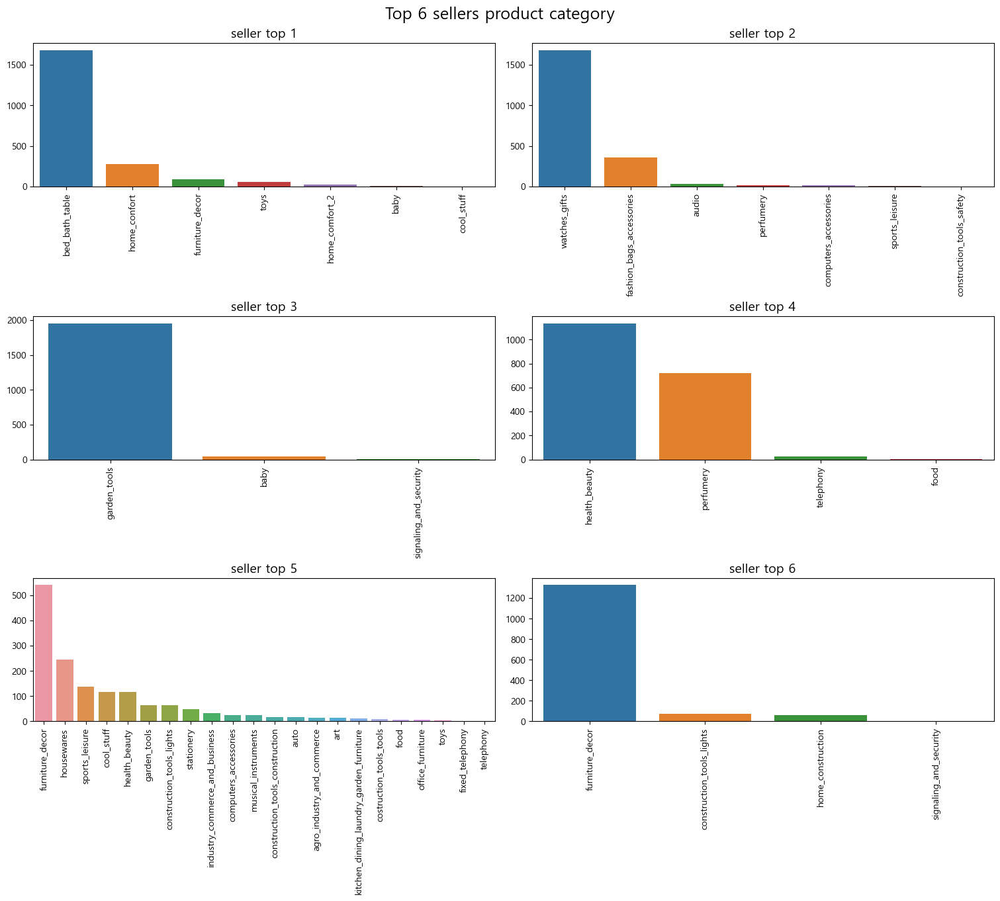

In [337]:
from matplotlib.gridspec import GridSpec
fig = plt.figure(constrained_layout=True, figsize=(15, 20))

# Axis definition
gs = GridSpec(6, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])
ax5 = fig.add_subplot(gs[2, 0])
ax6 = fig.add_subplot(gs[2, 1])

colors_list = ['lightskyblue', 'lightgreen']
explode = (0.0, 0.2)

# seller 1
seller_1_gra = sns.barplot(x=seller_top1['product_category_name_english'].value_counts().index, y=seller_top1['product_category_name_english'].value_counts().values,  data=seller_top1, ax=ax1)
ax1.set_xlabel("")
ax1.set_ylabel("")
ax1.set_title("seller top 1",size=14, color="black")
seller_1_gra.set_xticklabels(seller_1_gra.get_xticklabels(), rotation=90)

# seller 2
seller_2_gra = sns.barplot(x=seller_top2['product_category_name_english'].value_counts().index, y=seller_top2['product_category_name_english'].value_counts().values,  data=seller_top2, ax=ax2)
ax2.set_xlabel("")
ax2.set_ylabel("")
ax2.set_title("seller top 2",size=14, color="black")
seller_2_gra.set_xticklabels(seller_2_gra.get_xticklabels(), rotation=90)


# seller 3

seller_3_gra = sns.barplot(x=seller_top3['product_category_name_english'].value_counts().index, y=seller_top3['product_category_name_english'].value_counts().values,  data=seller_top3, ax=ax3)
ax3.set_xlabel("")
ax3.set_ylabel("")
ax3.set_title("seller top 3",size=14, color="black")
seller_3_gra.set_xticklabels(seller_3_gra.get_xticklabels(), rotation=90)

# seller 4 

seller_4_gra = sns.barplot(x=seller_top4['product_category_name_english'].value_counts().index, y=seller_top4['product_category_name_english'].value_counts().values,  data=seller_top4, ax=ax4)
ax4.set_xlabel("")
ax4.set_ylabel("")
ax4.set_title("seller top 4",size=14, color="black")
seller_4_gra.set_xticklabels(seller_4_gra.get_xticklabels(), rotation=90)


# seller 5 

seller_5_gra =sns.barplot(x=seller_top5['product_category_name_english'].value_counts().index, y=seller_top5['product_category_name_english'].value_counts().values,  data=seller_top5, ax=ax5)
ax5.set_xlabel("")
ax5.set_ylabel("")
ax5.set_title("seller top 5",size=14, color="black")
seller_5_gra.set_xticklabels(seller_5_gra.get_xticklabels(), rotation=90)

# seller 6 

seller_6_gra = sns.barplot(x=seller_top6['product_category_name_english'].value_counts().index, y=seller_top6['product_category_name_english'].value_counts().values,  data=seller_top6, ax=ax6)
ax6.set_xlabel("")
ax6.set_ylabel("")
ax6.set_title("seller top 6",size=14, color="black")
seller_6_gra.set_xticklabels(seller_6_gra.get_xticklabels(), rotation=90)


plt.suptitle("Top 6 sellers product category", size=18)

- seller top 6 까지 1~2가지 카테고리가 높은 비중으로 차지하는 경향이 있음. 
- seller top 5의 seller product category 판매 비중이 고루 분포되어있음을 확인. 

#### 상위 10개 상품 매출

In [461]:
total_orders=pd.merge(olist_orders, olist_order_items)
product_orders=pd.merge(total_orders,olist_products, on="product_id")

seller_products = pd.merge(product_orders, olist_sellers, on="seller_id")

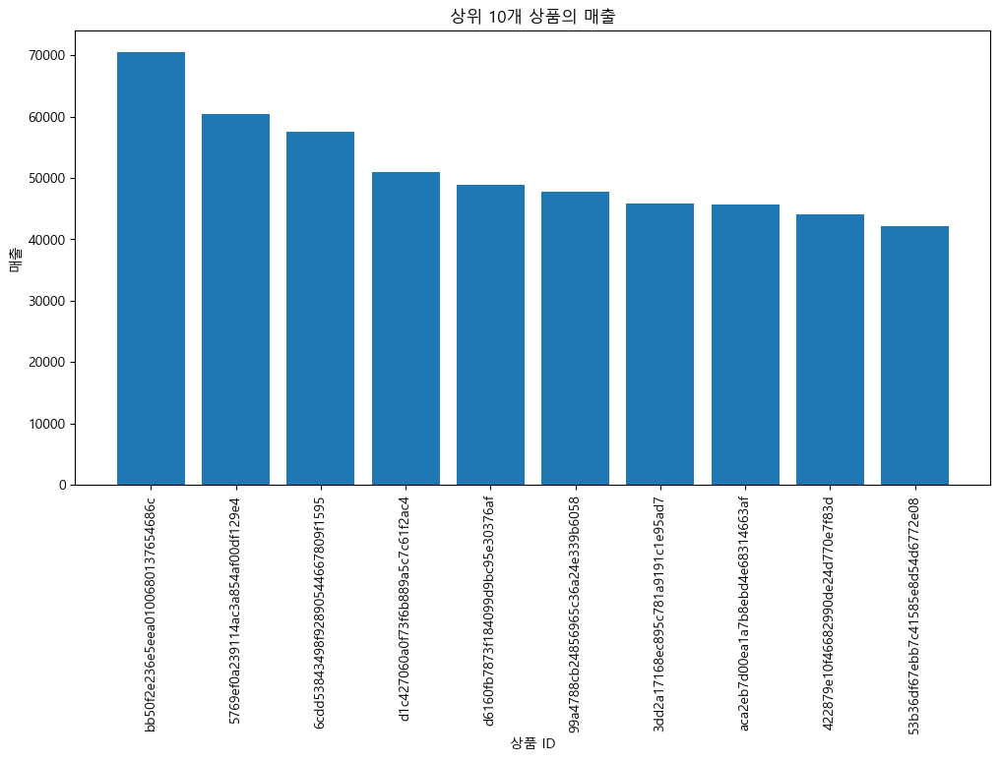

In [462]:
product_orders['revenue'] = product_orders['price'] * product_orders['order_item_id']
top_10_products = product_orders.groupby('product_id')['revenue'].sum().nlargest(10)
plt.figure(figsize=(12, 6))
plt.bar(top_10_products.index, top_10_products.values)
plt.xlabel('상품 ID')
plt.ylabel('매출')
plt.title('상위 10개 상품의 매출')
plt.xticks(rotation=90)
plt.show()

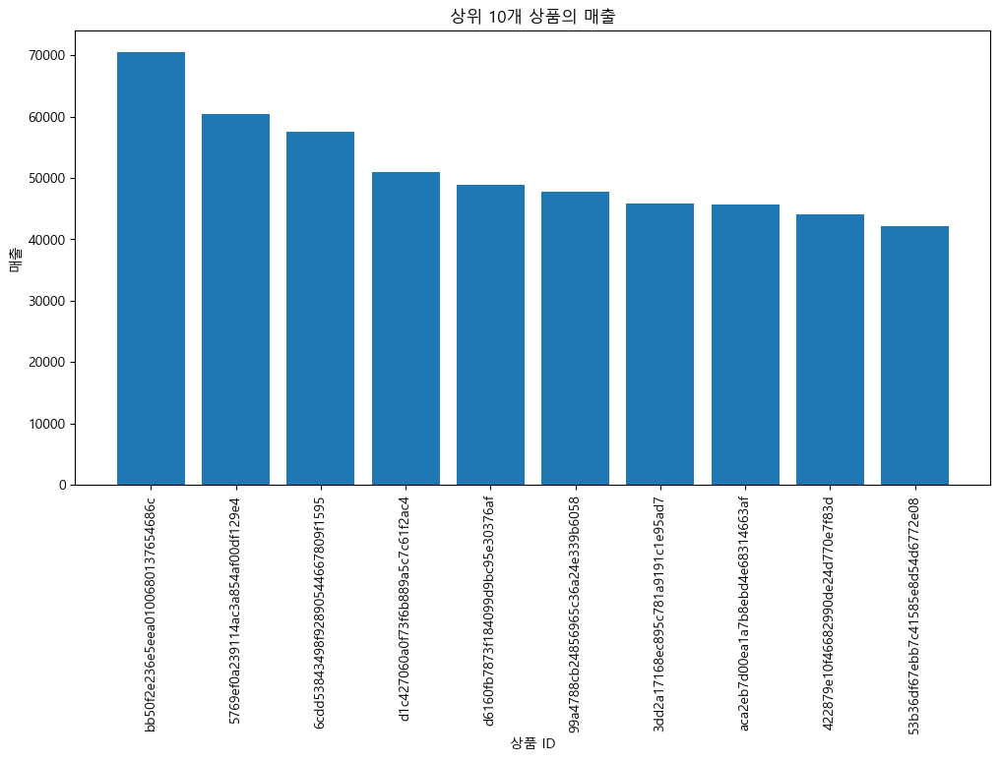

In [463]:
product_orders['revenue'] = product_orders['price'] * product_orders['order_item_id']
top_10_products = product_orders.groupby('product_id')['revenue'].sum().nlargest(10)
plt.figure(figsize=(12, 6))
plt.bar(top_10_products.index, top_10_products.values)
plt.xlabel('상품 ID')
plt.ylabel('매출')
plt.title('상위 10개 상품의 매출')
plt.xticks(rotation=90)
plt.show()

#### 상위 10개 상품 판매량

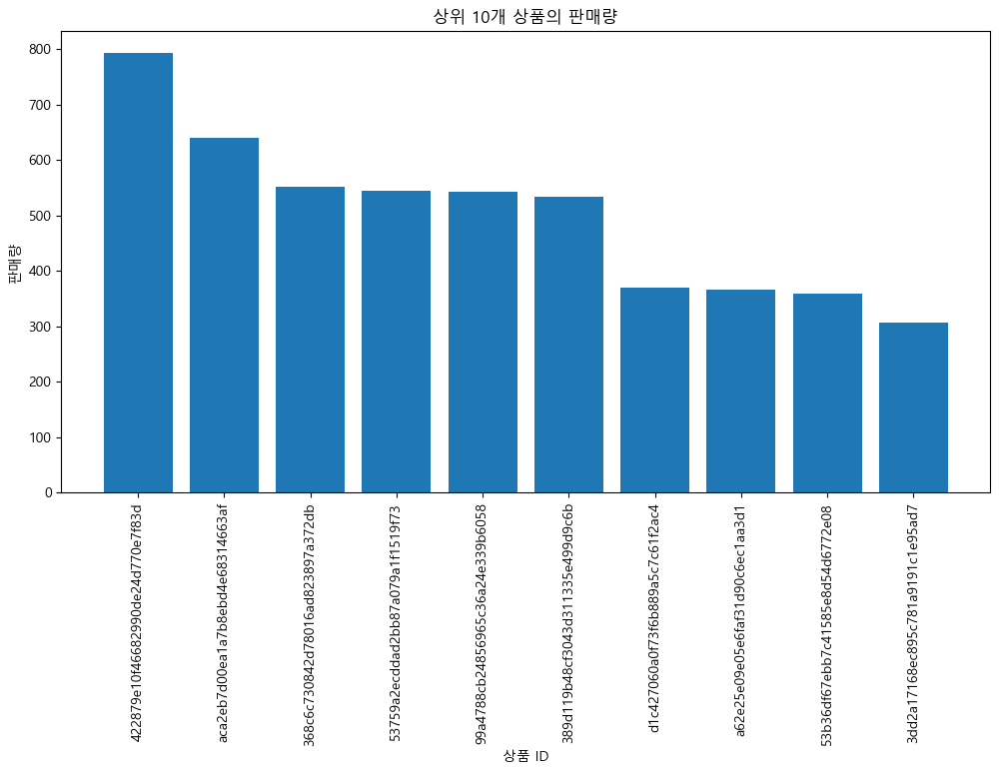

In [464]:
product_sales = product_orders.groupby('product_id')['order_item_id'].sum()
top_10_products = product_sales.nlargest(10)
plt.figure(figsize=(12, 6))
plt.bar(top_10_products.index, top_10_products.values)
plt.xlabel('상품 ID')
plt.ylabel('판매량')
plt.title('상위 10개 상품의 판매량')
plt.xticks(rotation=90)
plt.show()


- 매출 상위 10개 제품과 판매 상위 10개 제품의 목록이 일치하지 않는다. 

#### 카테고리별 상위 10개 매출

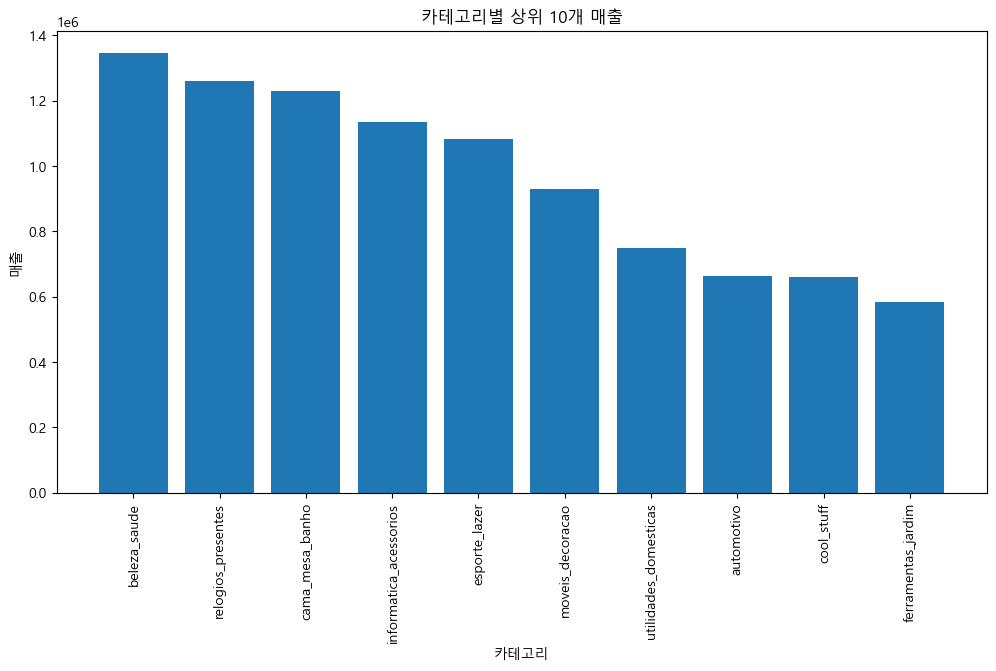

In [340]:
category_sales = product_orders.groupby('product_category_name')['revenue'].sum()
top_10_categories = category_sales.nlargest(10)
plt.figure(figsize=(12, 6))
plt.bar(top_10_categories.index, top_10_categories.values)
plt.xlabel('카테고리')
plt.ylabel('매출')
plt.title('카테고리별 상위 10개 매출')
plt.xticks(rotation=90)
plt.show()

#### 카테고리별 상위 10개 판매 수

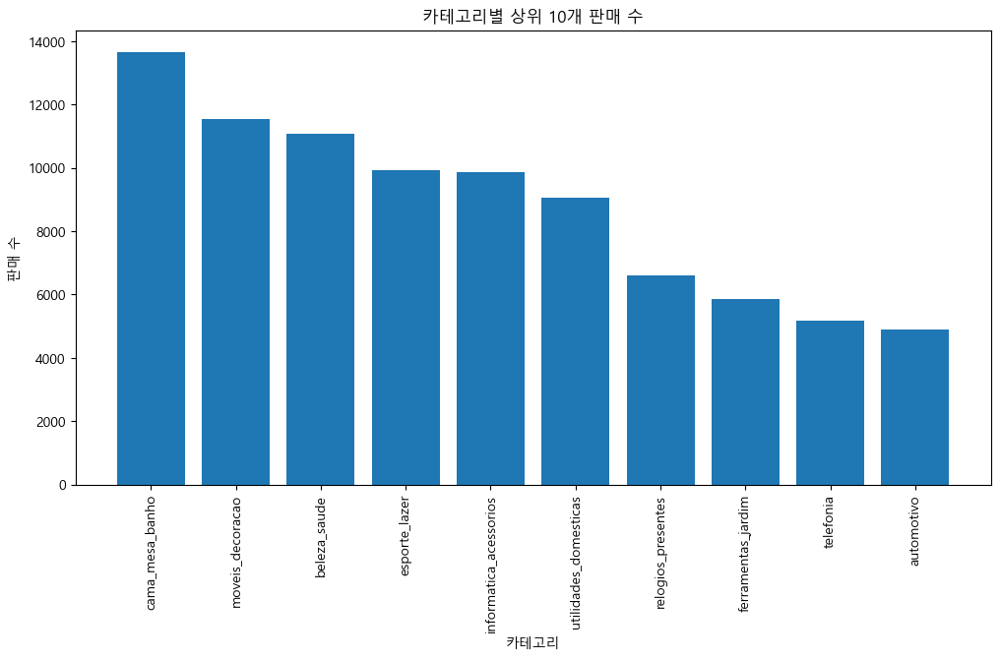

In [341]:
category_sales = product_orders.groupby('product_category_name')['order_item_id'].sum()
top_10_categories = category_sales.nlargest(10)
plt.figure(figsize=(12, 6))
plt.bar(top_10_categories.index, top_10_categories.values)
plt.xlabel('카테고리')
plt.ylabel('판매 수')
plt.title('카테고리별 상위 10개 판매 수')
plt.xticks(rotation=90)
plt.show()

- 가장 주문이 많은 카테고리는 bed_table_bath지만, 가장 많이 매출이 높은 카테고리는 health_beauty이다.

#### 판매자별 판매량 계산(상위 10위)

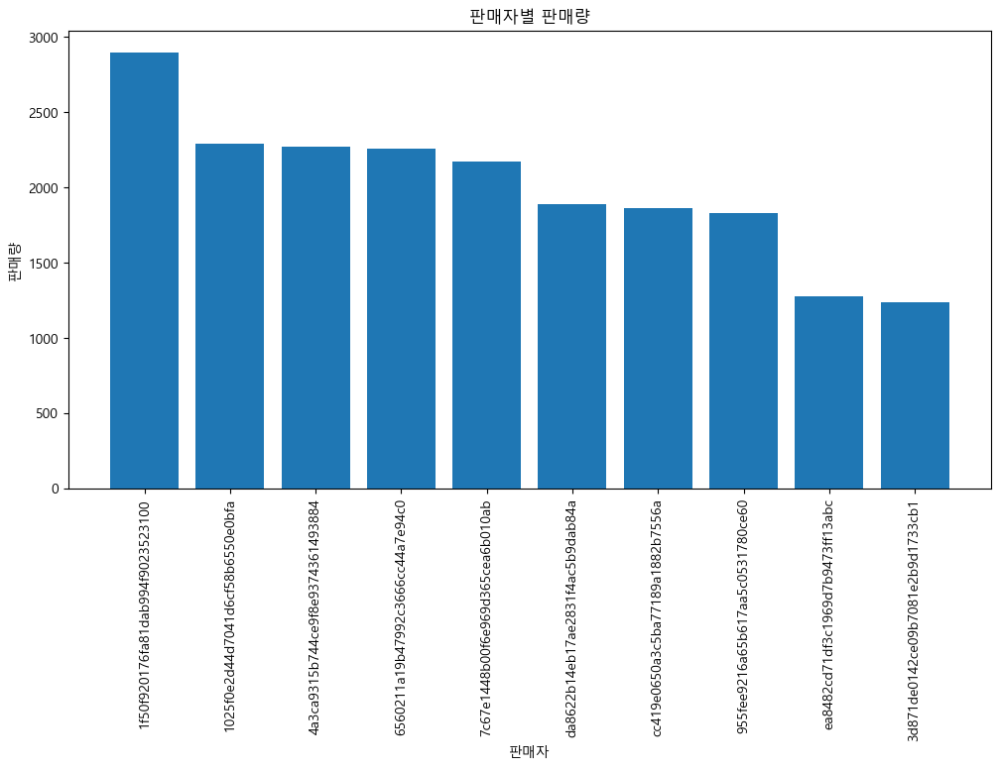

In [342]:
seller_sales = seller_products.groupby('seller_id')['order_item_id'].sum().sort_values(ascending=False).head(10)

plt.figure(figsize=(12, 6))
plt.bar(seller_sales.index, seller_sales.values)
plt.xlabel('판매자')
plt.ylabel('판매량')
plt.title('판매자별 판매량')
plt.xticks(rotation=90)
plt.show()


#### 판매자별 매출 계산

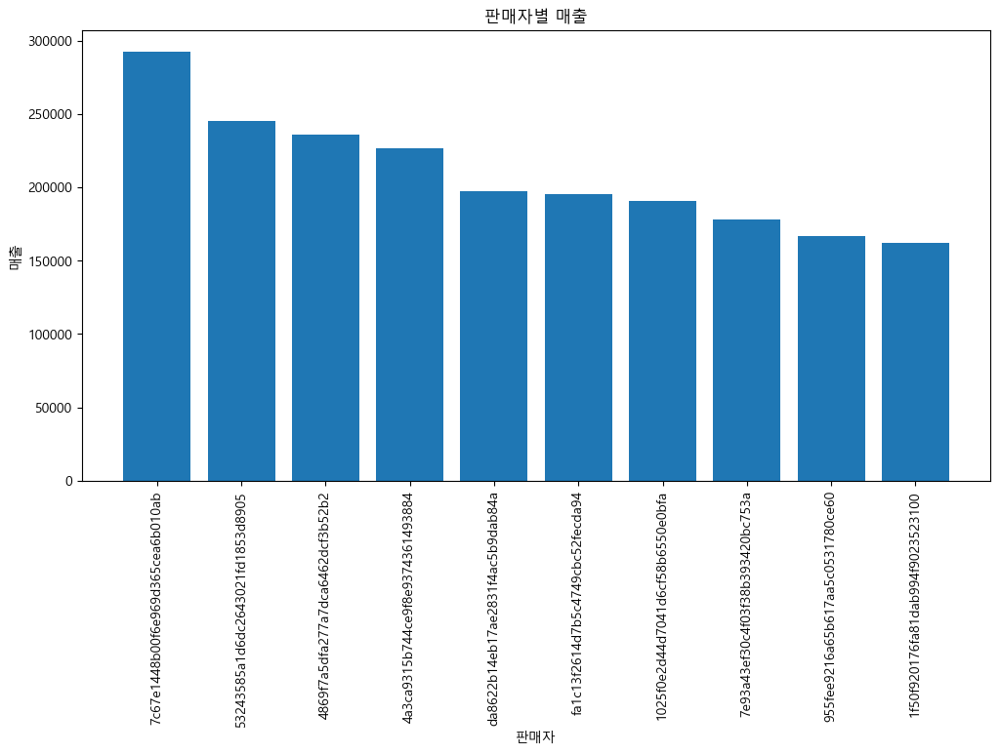

In [343]:
seller_products['revenue'] = seller_products['price'] * seller_products['order_item_id']

seller_revenue=seller_products.groupby('seller_id')['revenue'].sum().sort_values(ascending=False).head(10)
plt.figure(figsize=(12, 6))
plt.bar(seller_revenue.index, seller_revenue.values)
plt.xlabel('판매자')
plt.ylabel('매출')
plt.title('판매자별 매출')
plt.xticks(rotation=90)
plt.show()


#### 지역별 판매자 수 계산

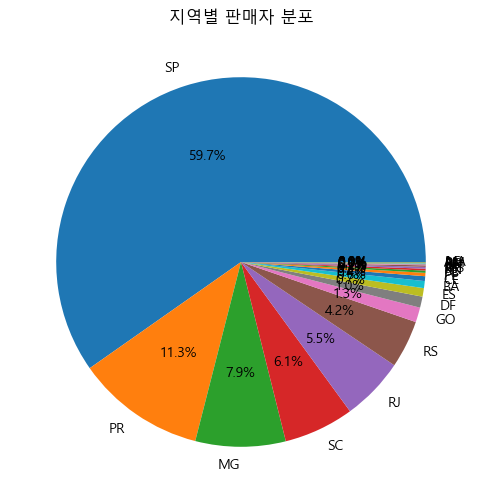

In [344]:
unique_sellers = seller_products.drop_duplicates(subset='seller_id')
seller_counts = unique_sellers['seller_state'].value_counts()

plt.figure(figsize=(10, 6))
plt.pie(seller_counts.values, labels=seller_counts.index, autopct='%1.1f%%')
plt.title('지역별 판매자 분포')
plt.show()



- 판매자는 SP(상파울루)에 59.7% 분하고 있으며 상위 5개지역에 약 90%의 판매자가 분포하고 있다.

#### 카테고리별 판매자 수 계산

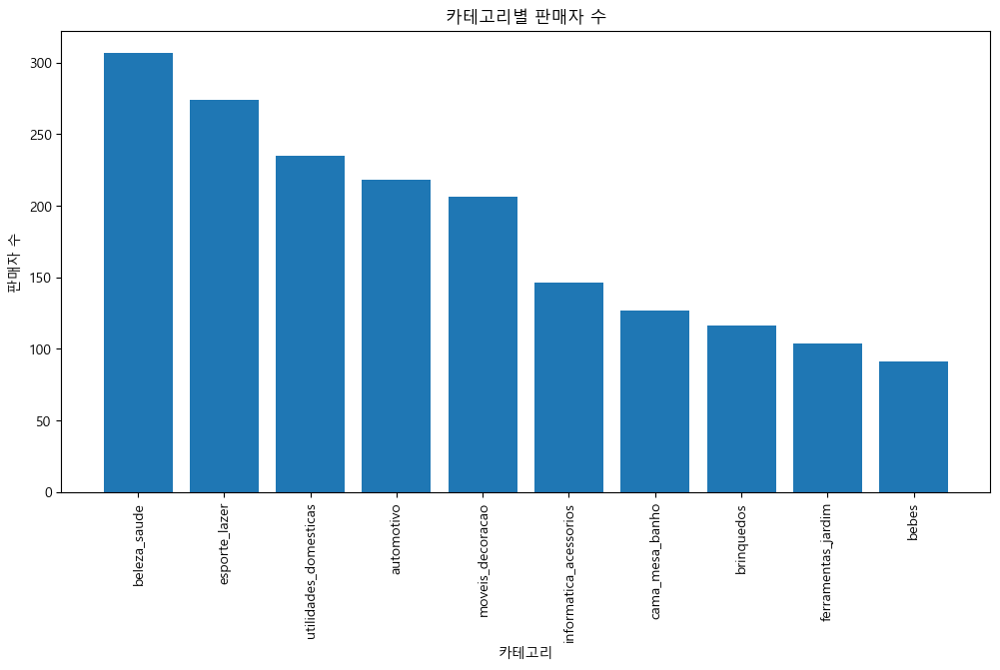

In [345]:
unique_sellers = seller_products.drop_duplicates(subset=['seller_id'])
seller_counts = unique_sellers['product_category_name'].value_counts().head(10)

plt.figure(figsize=(12, 6))
plt.bar(seller_counts.index, seller_counts.values)
plt.xlabel('카테고리')
plt.ylabel('판매자 수')
plt.title('카테고리별 판매자 수')
plt.xticks(rotation=90)
plt.show()


#### 판매자별 평균 평점 계산

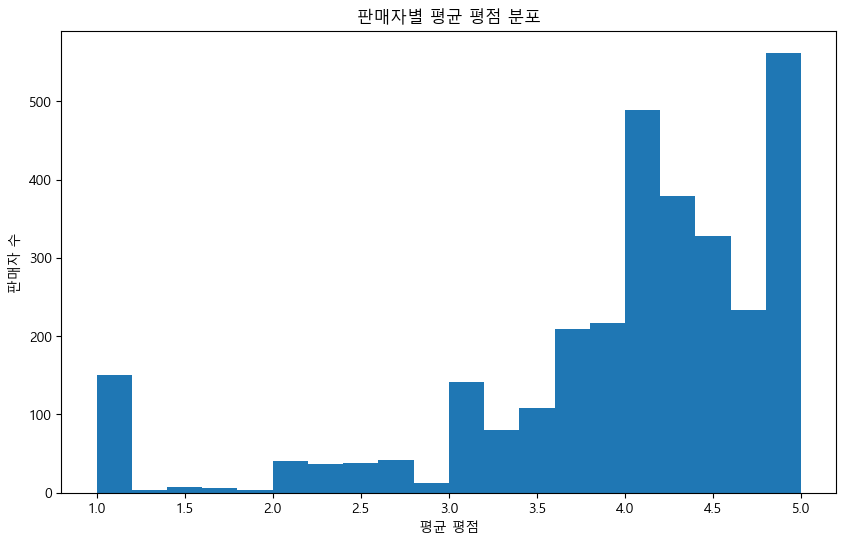

In [346]:
seller_avg_rating = merged_df_jb.groupby('seller_id')['review_score'].mean().sort_values(ascending=False)

plt.figure(figsize=(10, 6))
plt.hist(seller_avg_rating, bins=20)
plt.xlabel('평균 평점')
plt.ylabel('판매자 수')
plt.title('판매자별 평균 평점 분포')
plt.show()


#### tax와 review_score, price, freight_value, customer_state_code, seller_state_code, customer unique id

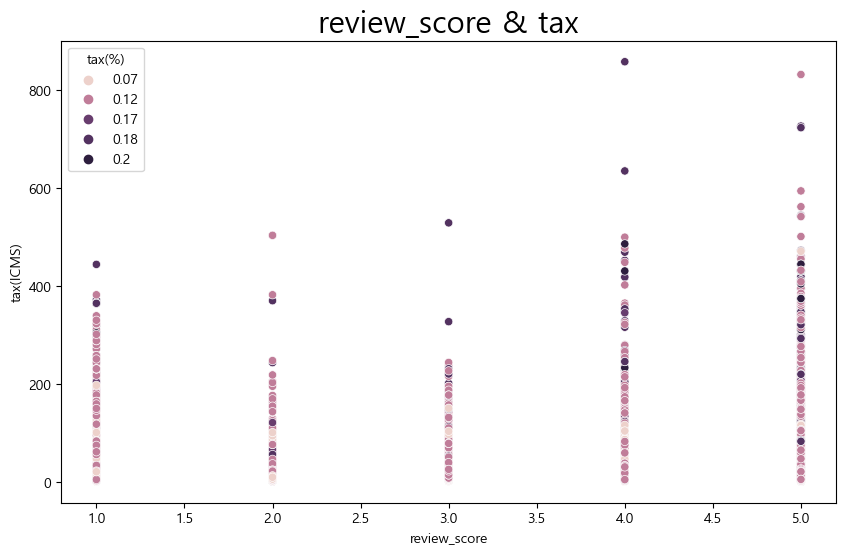

In [256]:
x = df_merge['review_score']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('review_score & tax', fontsize=22)
s1 = sns.scatterplot(x=x, y=y, hue='tax(%)', data=df_merge)

# plt.xlabel('price', fontsize=17)
# plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

- 유류세
- 브라질에서 출판물을 제외한 우편화물의 경우 과세 대상 금액(상품가격 + 운송비 + 보험료)에 대해 일률적으로 세금 부과 
- 상품 유통 서비스세를 부과 

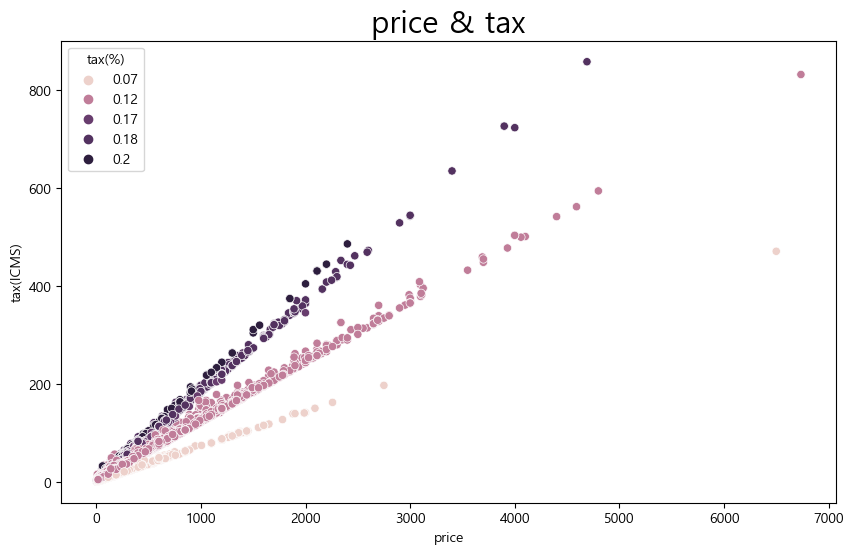

In [347]:
x = df_merge['price']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('price & tax', fontsize=22)
s1 = sns.scatterplot(x=x, y=y, hue='tax(%)', data=df_merge)

# plt.xlabel('price', fontsize=17)
# plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

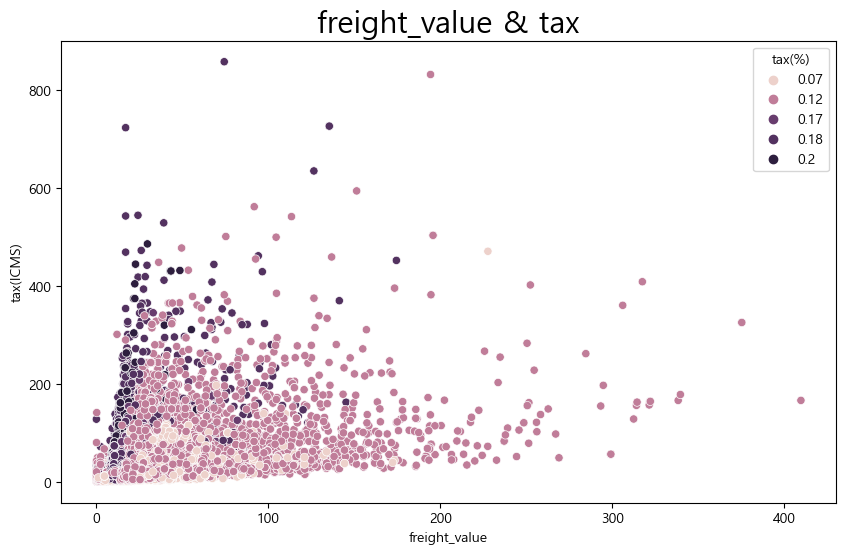

In [348]:
x = df_merge['freight_value']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('freight_value & tax', fontsize=22)
s1 = sns.scatterplot(x=x, y=y, hue='tax(%)', data=df_merge)

# plt.xlabel('price', fontsize=17)
# plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

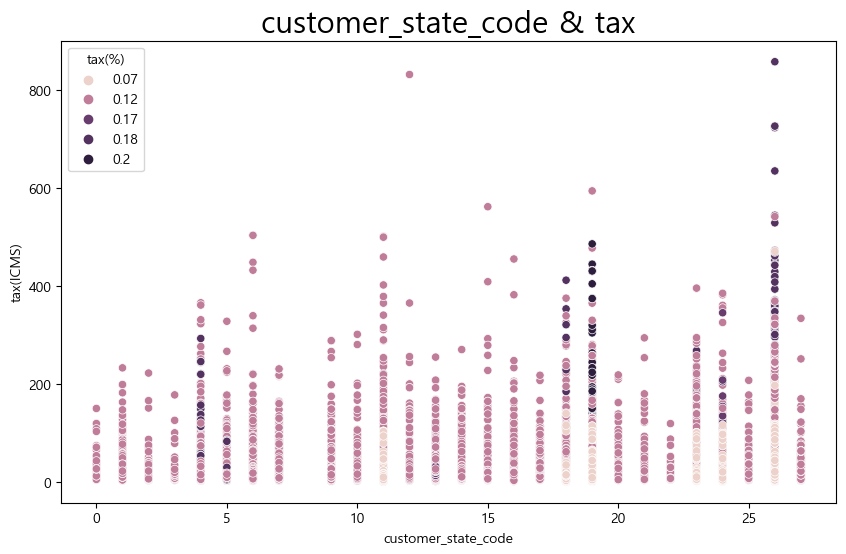

In [349]:
x = df_merge['customer_state_code']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('customer_state_code & tax', fontsize=22)
s1 = sns.scatterplot(x=x, y=y, hue='tax(%)', data=df_merge)

# plt.xlabel('price', fontsize=17)
# plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

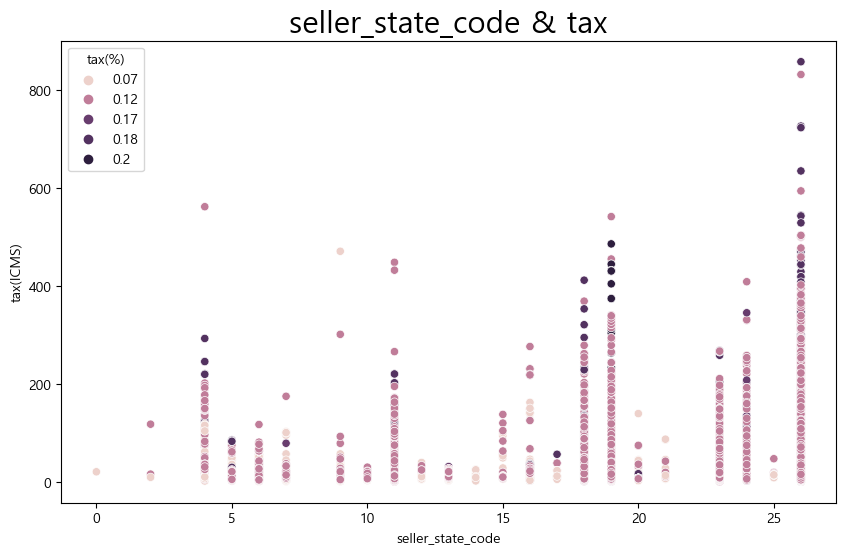

In [260]:
x = df_merge['seller_state_code']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('seller_state_code & tax', fontsize=22)
s1 = sns.scatterplot(x=x, y=y, hue='tax(%)', data=df_merge)

# plt.xlabel('price', fontsize=17)
# plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

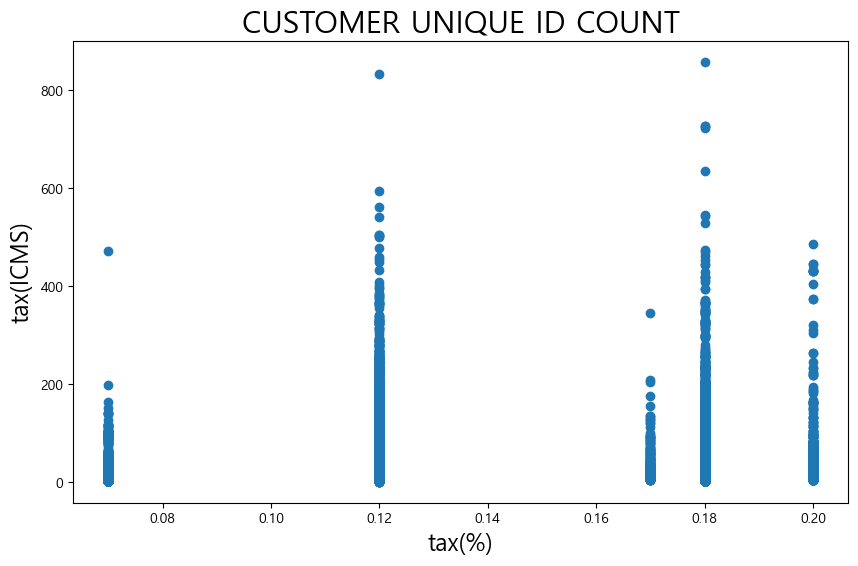

In [261]:
x = df_merge['tax(%)']
y = df_merge['tax(ICMS)']

plt.figure(figsize=(10,6))
plt.title('CUSTOMER UNIQUE ID COUNT', fontsize=22)
s = plt.scatter(x,y)
plt.xlabel('tax(%)', fontsize=17)
plt.ylabel('tax(ICMS)', fontsize=17)
plt.show()

---

### 5) 금액

#### 주문별 결제수단 확인

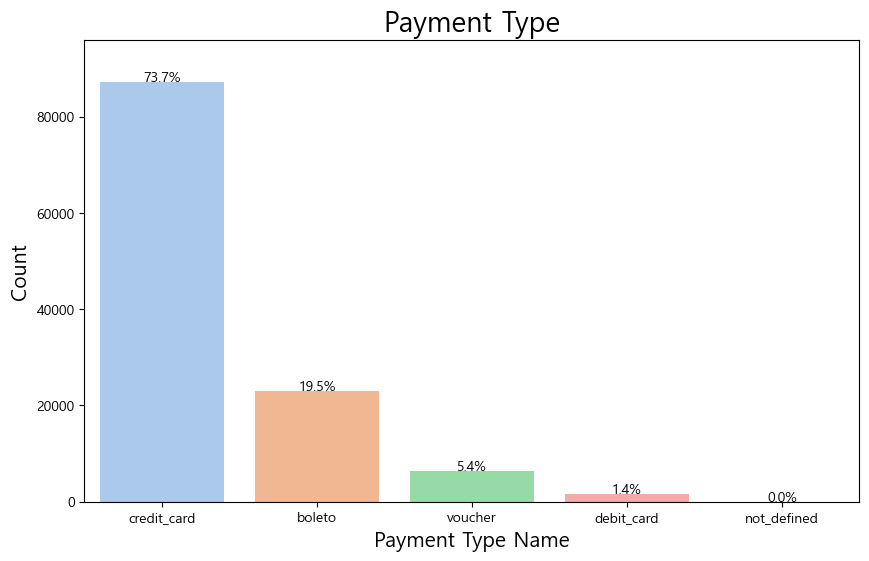

In [446]:
count_plot(df_jo, df_jo['payment_type'], 'pastel', 'Payment Type', 'Payment Type Name', 'Count')

- 모든 판매건의 결제수단 중 credit card가 73% 이상으로 가장 일반적인 결제 수단이며 그 다음으로 boleto(19.5%), voucher(5.4%) 등이 많이 사용

In [447]:
time = df_jo[['order_id', 'order_purchase_timestamp', 'price']].set_index('order_purchase_timestamp', inplace=False)

df_time_jo = pd.DataFrame(time.resample('W')['price'].sum())
# 마지막 6주 연속으로 price가 0이어서 이상치로 판단해 제거
df_time_jo.drop(df_time_jo.tail(6).index, inplace=True)
df_time_jo

,price
order_purchase_timestamp,
2016-09-04,72.89
2016-09-11,59.50
2016-09-18,134.97
2016-09-25,0.00
2016-10-02,100.00
...,...
2018-08-12,288122.23
2018-08-19,257414.84
2018-08-26,128453.12


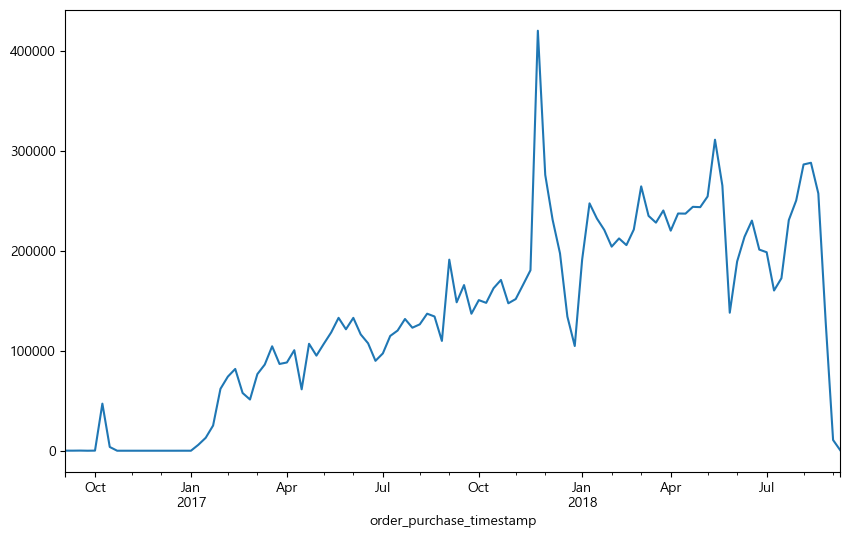

In [448]:
df_time_jo['price'].plot(figsize=(10,6));

---

### 6) 리뷰

#### 리뷰 평점 분포

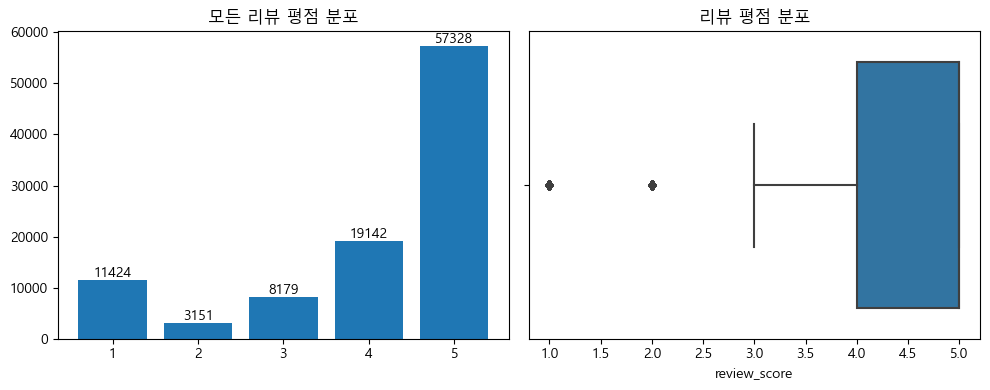

In [265]:
query="""
select review_score, count(*) cnt
from order_reviews 
group by review_score
order by review_score;
"""

counts=get_query(query)


fig, axs =  plt.subplots(1, 2, figsize=(10, 4))

bars = axs[0].bar(counts.review_score, counts.cnt)
axs[0].set_title('모든 리뷰 평점 분포')

for bar in bars:
    height = bar.get_height()
    axs[0].text(bar.get_x() + bar.get_width() / 2, height, str(int(height)), ha='center', va='bottom')

sns.boxplot(data=olist_order_reviews, x='review_score')
axs[1].set_title('리뷰 평점 분포')

plt.tight_layout()
plt.show()

In [266]:
# 리뷰 제목은 null값이지만, 내용은 있음 -> 31138
# 리뷰 제목은 있지만, 내용은 null값 -> 1729

print('리뷰 제목 o, 내용 x :' ,len(olist_order_reviews[(olist_order_reviews['review_comment_title'].isnull()) & (olist_order_reviews['review_comment_message'].notnull())]))
print('리뷰 제목 x, 내용 o :' , len(olist_order_reviews[(olist_order_reviews['review_comment_title'].notnull()) & (olist_order_reviews['review_comment_message'].isnull())]))

# 리뷰, 제목 둘 다 null값 : 56518

review_null=olist_order_reviews[(olist_order_reviews['review_comment_title'].isnull()) & (olist_order_reviews['review_comment_message'].isnull())]

리뷰 제목 o, 내용 x : 31138
리뷰 제목 x, 내용 o : 1729


#### 평점 별 리뷰 쓰지 않은 비율

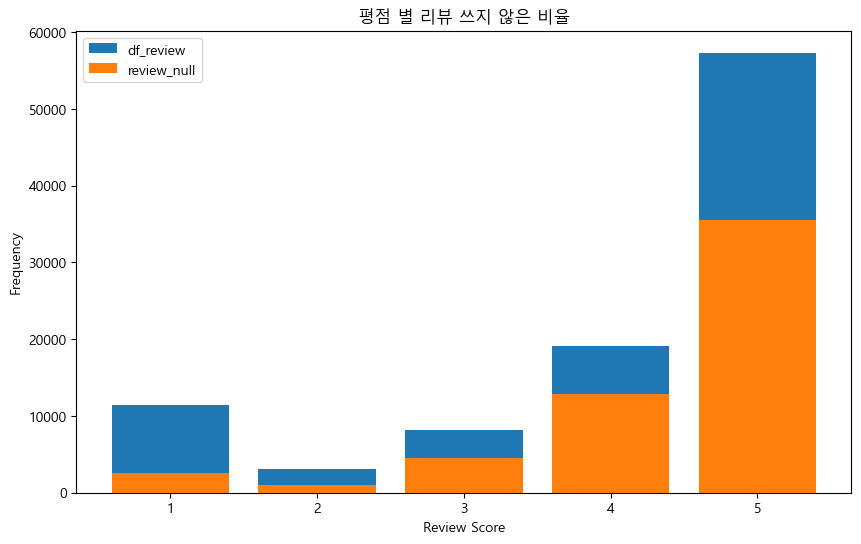

In [267]:
plt.figure(figsize=(10, 6))
plt.bar(olist_order_reviews.review_score.value_counts().index, olist_order_reviews.review_score.value_counts().values, label='df_review')
plt.bar(review_null.review_score.value_counts().index, review_null.review_score.value_counts().values, label='review_null')
plt.xlabel('Review Score')
plt.ylabel('Frequency')
plt.title('평점 별 리뷰 쓰지 않은 비율')
plt.legend()
plt.show()

- 4점을 준 고객이 리뷰를 많이 씀
- 1점 준 고객 리뷰 적게 씀

In [449]:
# NaN값이 굉장히 많아서 결측치를 제거해준다.
olist_order_reviews_tmp = olist_order_reviews.dropna(subset=['review_comment_message'])

#### 리뷰에 따른 wordcloud

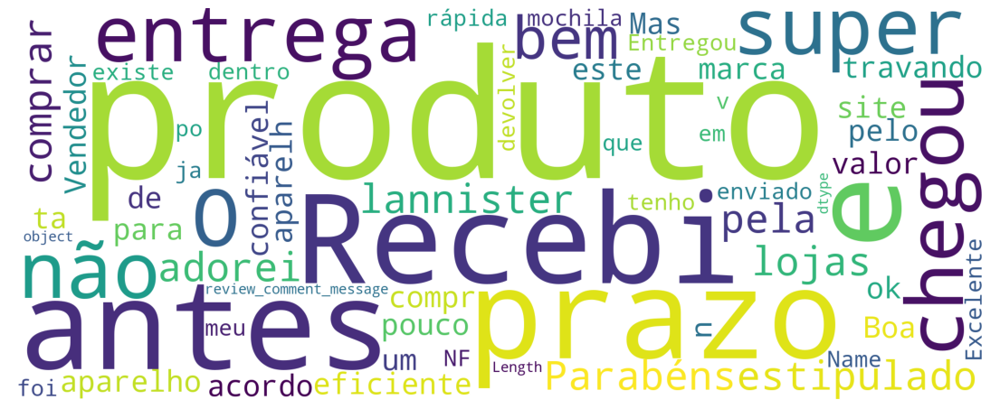

In [450]:
from wordcloud import WordCloud, STOPWORDS

stop_words = set(STOPWORDS)
wordcloud = WordCloud(background_color = 'white', stopwords = stop_words, width = 2000, height = 800).generate(str(olist_order_reviews_tmp['review_comment_message']))

plt.figure(figsize=(14,14))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

#### review_score 기준으로 데이터 나누기

In [451]:
from collections import defaultdict
review_score_bad = olist_order_reviews_tmp[olist_order_reviews_tmp["review_score"]<3]
review_score_good = olist_order_reviews_tmp[olist_order_reviews_tmp["review_score"]>=3]

In [ ]:
# 리뷰 데이터 추출

plt.figure(figsize=(12,7))

# WordCloud 생성
wordcloud3 = WordCloud(width=500, height=300, background_color="white").generate(" ".join(olist_order_reviews_tmp[olist_order_reviews_tmp["review_score"]<3]["review_comment_message"]))

# 그래프 출력
plt.subplot(1,2,1)

plt.imshow(wordcloud3, interpolation="bilinear")
plt.axis("off")
plt.title('3점 미만(부정) 리뷰')


wordcloud4 = WordCloud(width=500, height=300, background_color="white").generate(" ".join(olist_order_reviews_tmp[olist_order_reviews_tmp["review_score"]>=3]["review_comment_message"]))

plt.subplot(1,2,2)

plt.imshow(wordcloud4, interpolation="bilinear")
plt.axis("off")
plt.title('3점 이상(긍정) 리뷰')

plt.show()

#### 함수 설정 

In [453]:
def generate_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(" ") if token != "" if token not in STOPWORDS]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [" ".join(ngram) for ngram in ngrams]

def horizontal_bar_chart(df, color):
    trace = go.Bar(
        y=df["word"].values[::-1],
        x=df["wordcount"].values[::-1],
        showlegend=False,
        orientation = 'h',
        marker=dict(
            color=color,
        ),
    )
    return trace

#### 1-gram 단위로 분석
- review_score가 3점 미만이면 부정, 3점 이상이면 긍정

In [124]:
# Good
freq_dict = defaultdict(int)
for sent in review_score_good["review_comment_message"]:
    for word in generate_ngrams(sent):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace0 = horizontal_bar_chart(fd_sorted.head(30), 'blue')

# bad
freq_dict = defaultdict(int)
for sent in review_score_bad["review_comment_message"]:
    for word in generate_ngrams(sent):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace1 = horizontal_bar_chart(fd_sorted.head(30), 'red')

# 시각화
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of score 3 to 5", 
                                          "Frequent words of score 1 to 2"])
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig['layout'].update(height=800, width=1000, paper_bgcolor='rgb(233,233,233)', title="Word Count Plots - 1")
py.iplot(fig, filename='word-plots')

- produto : 제품 / muilto : 매우 / antes : ~ 전에
- nao : 아니오 / que : 무엇

In [125]:
# Good
freq_dict = defaultdict(int)
for sent in review_score_good["review_comment_message"]:
    for word in generate_ngrams(sent,2):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace0 = horizontal_bar_chart(fd_sorted.head(30), 'blue')

# bad
freq_dict = defaultdict(int)
for sent in review_score_bad["review_comment_message"]:
    for word in generate_ngrams(sent,2):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace1 = horizontal_bar_chart(fd_sorted.head(30), 'red')

# 시각화
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of score 3 to 5", 
                                          "Frequent words of score 1 to 2"])
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig['layout'].update(height=800, width=1200, paper_bgcolor='rgb(233,233,233)', title="Word Count Plots - 1")
py.iplot(fig, filename='word-plots')

- antes prazo : 마감일전에 / muito bom : 매우좋은 / chegou antes : 전에 도착
- nao recebi : 받지못했다 / ainda nao : 아직아님 / produto nao : 제품없음
- 어느정도 부정과 긍정단어 사이의 차이가 보인다.

In [126]:
# Good
freq_dict = defaultdict(int)
for sent in review_score_good["review_comment_message"]:
    for word in generate_ngrams(sent,3):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace0 = horizontal_bar_chart(fd_sorted.head(30), 'blue')

# bad
freq_dict = defaultdict(int)
for sent in review_score_bad["review_comment_message"]:
    for word in generate_ngrams(sent,3):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace1 = horizontal_bar_chart(fd_sorted.head(30), 'red')

# 시각화
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of score 3 to 5", 
                                          "Frequent words of score 1 to 2"])
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig['layout'].update(height=800, width=1400, paper_bgcolor='rgb(233,233,233)', title="Word Count Plots - 1")
py.iplot(fig, filename='word-plots')

- o produto chegou : 제품이 도착했습니다. / chegou antes prazo : 마감시간전에 도착 / recebi o produto : 나는 제품을 받았다.
- nao recebi o : 나는 받지 않았다 / recebi o produto : 나는 제품을 받았다.
- 더 큰 차이를 보여주긴 하지만, 긍정과 부정사이에 겹치는 문장들이 존재한다.

In [127]:
# Good
freq_dict = defaultdict(int)
for sent in review_score_good["review_comment_message"]:
    for word in generate_ngrams(sent,4):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace0 = horizontal_bar_chart(fd_sorted.head(30), 'blue')

# bad
freq_dict = defaultdict(int)
for sent in review_score_bad["review_comment_message"]:
    for word in generate_ngrams(sent,4):
        freq_dict[word] += 1
fd_sorted = pd.DataFrame(sorted(freq_dict.items(), key=lambda x: x[1])[::-1])
fd_sorted.columns = ["word", "wordcount"]
trace1 = horizontal_bar_chart(fd_sorted.head(30), 'red')

# 시각화
fig = tools.make_subplots(rows=1, cols=2, vertical_spacing=0.04,
                          subplot_titles=["Frequent words of score 3 to 5", 
                                          "Frequent words of score 1 to 2"])
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig['layout'].update(height=800, width=1600, paper_bgcolor='rgb(233,233,233)', title="Word Count Plots - 1")
py.iplot(fig, filename='word-plots')

- o produto foi entrgue : 제품이 배송되었습니다 / o produto chegou antes : 전에 도착한 제품 / produto chegou antes prazo : 마감일 전에 도착한 제품
- nao recebi o produto : 상품을 받지 못했다. / ainda ano recebi o : 나는 여전히 / o produto nao foi : 제품은 아니었다.
- 이제 극명한 차이를 보이고있다.

---

### 7) 배송

In [268]:
df_jw_1.order_status.value_counts()

delivered      108458
shipped          1084
canceled          513
invoiced          346
processing        339
unavailable         7
approved            3
Name: order_status, dtype: int64

#### order_status

#### review_score별 order_status

In [52]:

query = """
describe order_reviews
"""
get_query(query)


,Field,Type,Null,Key,Default,Extra
0,review_id,b'text',YES,,None,
1,order_id,b'text',YES,,None,
2,review_score,b'bigint',YES,,None,
3,review_comment_title,b'text',YES,,None,
4,review_comment_message,b'text',YES,,None,
5,review_creation_date,b'text',YES,,None,
6,review_answer_timestamp,b'text',YES,,None,


#### delivered 제외

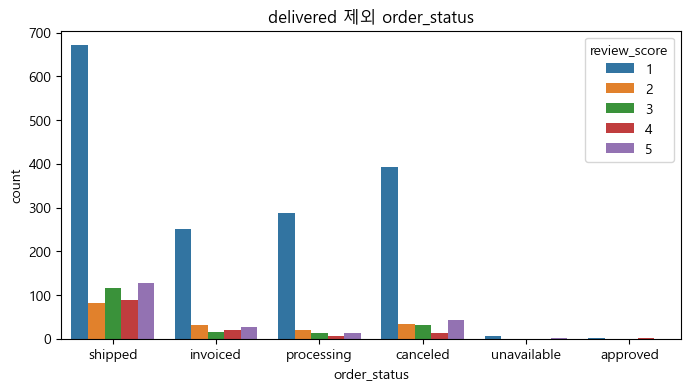

In [380]:
plt.figure(figsize=(8,4))
ax = sns.countplot(x='order_status', data=df_jw_1[df_jw_1['order_status'] != 'delivered'], hue='review_score')

plt.title('delivered 제외 order_status')
plt.show()

#### 배송날짜

In [381]:
# pd.to_datetime

to_date=['order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date']

for i in to_date:
    df_jw_1[i]=pd.to_datetime(df_jw_1[i])


#### 배송 예측날짜 - 도착날짜 

In [382]:
df_jw_1['day_diff']=(df_jw_1['order_estimated_delivery_date']-df_jw_1['order_delivered_customer_date']).dt.days
df_jw_1.tail()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,day_diff
110745,8325d6e7af2f2bfb58cf040729b232dd,a1d53377ab83871b0ad483b03ac69d6c,3570,sao paulo,SP,b99217b1fcf2fdeace7b8d869b76cb91,delivered,2018-03-07 17:42:06,2018-03-07 17:55:36,2018-03-08 20:09:40,...,1.0,100.0,16.0,16.0,16.0,90010,porto alegre,RS,fashion_childrens_clothes,17.0
110746,f4b4417d306cbf8c55ea65c89d0261f7,27558f96bc671d0594c60be61566aeb4,46500,macaubas,BA,cab08f0417a702d0f4782ec02356a4ac,delivered,2017-09-30 18:54:53,2017-10-03 04:28:12,2017-10-03 18:54:12,...,3.0,300.0,30.0,20.0,20.0,3929,sao paulo,SP,fashion_childrens_clothes,1.0
110747,035c08a68b237ef4afc82109e61a7380,e4469e5047c00b0188885853d357d2ab,4116,sao paulo,SP,cb53f0b6e8f9082a9f5a113765dd1236,delivered,2018-06-03 22:34:58,2018-06-03 22:50:09,2018-06-04 15:15:00,...,3.0,300.0,30.0,20.0,20.0,3929,sao paulo,SP,fashion_childrens_clothes,22.0
110748,14acb30bbc064408dcb8cdd3c92b0c97,1b553902a5bbe6ee54a3aaa7cbfb6816,26255,nova iguacu,RJ,ee86b68eb9222b0cad7da50f4f758a35,delivered,2017-05-17 17:44:34,2017-05-17 17:55:12,2017-05-18 16:28:06,...,4.0,600.0,36.0,10.0,26.0,5685,sao paulo,SP,fashion_childrens_clothes,19.0
110749,2415312e36eac3ab3819f5b7f32522e5,1f83c87997168e248ea52ad3453b069f,4128,sao paulo,SP,3da4b0f0c89bb8fee8a810459e641414,delivered,2017-06-08 16:46:33,2017-06-08 18:20:19,2017-06-12 15:31:40,...,5.0,500.0,36.0,10.0,26.0,5685,sao paulo,SP,fashion_childrens_clothes,9.0


In [383]:
# 예상날짜와 실제 도착 날짜 평균 : 12일 차이
# 최소 : -189일
# 최대 : 146일 

df_jw_1.day_diff.describe()

count    108457.000000
mean         11.080271
std          10.086804
min        -189.000000
25%           6.000000
50%          12.000000
75%          16.000000
max         146.000000
Name: day_diff, dtype: float64

In [384]:
# 구매 날짜, 승인 날짜, 물류 파트너사 도착, 도착날짜, 예상날짜, 예상 - 도착
delivery_jw=df_jw_1[[ 'order_purchase_timestamp','order_approved_at','order_delivered_carrier_date', 'order_delivered_customer_date','order_estimated_delivery_date',  'day_diff', 'order_status']]
delivery_jw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110750 entries, 0 to 110749
Data columns (total 7 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_purchase_timestamp       110750 non-null  datetime64[ns]
 1   order_approved_at              110736 non-null  datetime64[ns]
 2   order_delivered_carrier_date   109605 non-null  datetime64[ns]
 3   order_delivered_customer_date  108457 non-null  datetime64[ns]
 4   order_estimated_delivery_date  110750 non-null  datetime64[ns]
 5   day_diff                       108457 non-null  float64       
 6   order_status                   110750 non-null  object        
dtypes: datetime64[ns](5), float64(1), object(1)
memory usage: 6.8+ MB


In [275]:
# 물류 파트너사에 도착했지만 못받은 물건이 1176건
delivery_jw.isnull().sum()

order_purchase_timestamp            0
order_approved_at                  14
order_delivered_carrier_date     1145
order_delivered_customer_date    2293
order_estimated_delivery_date       0
day_diff                         2293
order_status                        0
dtype: int64

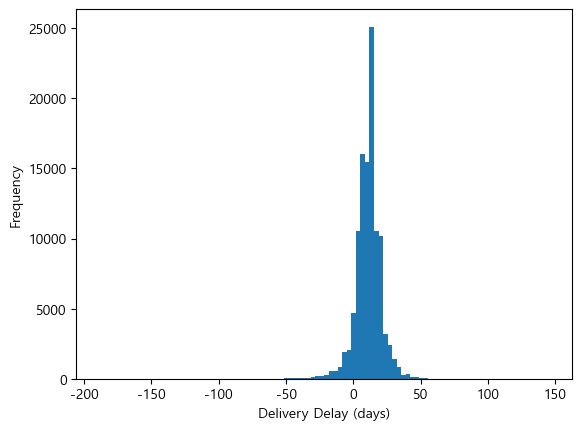

In [385]:
plt.rcParams['axes.unicode_minus'] = False


plt.hist(df_jw_1['day_diff'], bins=100)
plt.xlabel('Delivery Delay (days)')
plt.ylabel('Frequency')
plt.show()

#### 년도&월별 주문 수

In [386]:
# 2018년 55076건으로 가장 높음

orders_by_year_jw = olist_orders.groupby(df_jw_1['order_delivered_customer_date'].dt.year)['order_id'].count()
orders_by_year_jw

order_delivered_customer_date
2016.0      286
2017.0    42026
2018.0    55076
Name: order_id, dtype: int64

In [393]:
# 월별 배달 수
# 배달 6000건 넘는 월 : 2018-04, 2018-08, 2017-12, 2018-03, 2018-05, 2018-06, 2018-01
orders_by_month_jw = olist_orders.groupby(df_jw_1['order_delivered_customer_date'].dt.to_period('M'))['order_id'].count()

#### 배송 많은 top10 지역

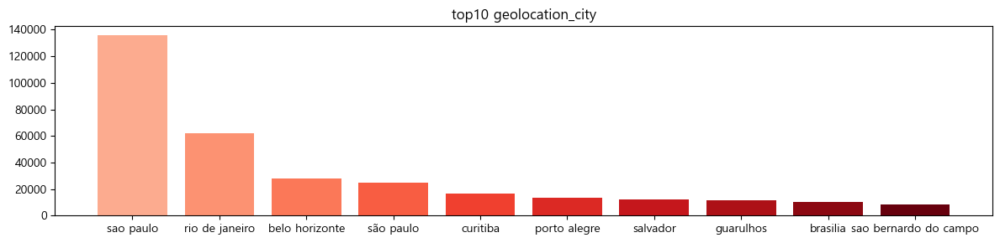

In [180]:
olist_geolocation.geolocation_city.value_counts()[:10]

values_jw = olist_geolocation.geolocation_city.value_counts()[:10]
colors_jw = np.linspace(0.3, 1, len(values_jw))

plt.figure(figsize=(12, 3))
plt.bar(values_jw.index, values_jw, color=plt.cm.Reds(colors_jw))
plt.title('top10 geolocation_city')
plt.tight_layout()
plt.grid(False)
plt.show()

In [277]:
conn.close()

---